In [1]:
import matplotlib.pyplot as plt
import anndata as adata
import scanpy as sc
from wmb import cemba, mm10
from ALLCools.mcds import MCDS
from ALLCools.clustering import significant_pc_test
from ALLCools.plot import *
import pandas as pd
from harmonypy import run_harmony

In [2]:
import os
default_n_threads = 8
os.environ['OPENBLAS_NUM_THREADS'] = f"{default_n_threads}"
os.environ['MKL_NUM_THREADS'] = f"{default_n_threads}"
os.environ['OMP_NUM_THREADS'] = f"{default_n_threads}"

In [3]:
!export OPENBLAS_NUM_THREADS=8
!export MKL_NUM_THREADS=8
!export OMP_NUM_THREADS=8

In [4]:
adata_sc = adata.read_h5ad("/data1st1/hydata/pfc_3tech_int_byID.h5ad")

In [5]:
adata_sc.var.columns

Index(['mt', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0',
       'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0',
       'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0',
       'highly_variable_rank-0', 'variances-0', 'variances_norm-0',
       'highly_variable_nbatches-0', 'n_cells_by_counts-1', 'mean_counts-1',
       'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1',
       'log1p_total_counts-1', 'highly_variable-1', 'means-1',
       'highly_variable_rank-1', 'variances-1', 'variances_norm-1',
       'highly_variable_nbatches-1', 'highly_variable', 'highly_variable_rank',
       'means', 'variances', 'variances_norm', 'highly_variable_nbatches'],
      dtype='object')

In [6]:
adata_sc.obs.columns

Index(['sample', 'group', 'n_genes_by_counts', 'log1p_n_genes_by_counts',
       'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes',
       'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes',
       'pct_counts_in_top_500_genes', 'doublet_score', 'predicted_doublet',
       'batch', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'pred_dmb',
       'pred_mwb', 'pred_mdg', 'pred_mih', 'pred_mpd', 'sampleID', 'tech',
       'louvain'],
      dtype='object')

In [7]:
adata_sc.obsm.keys()

KeysView(AxisArrays with keys: X_pca, X_pca_harmony, X_umap, X_umap_1, X_umap_raw)

Red axis labels are used PCs


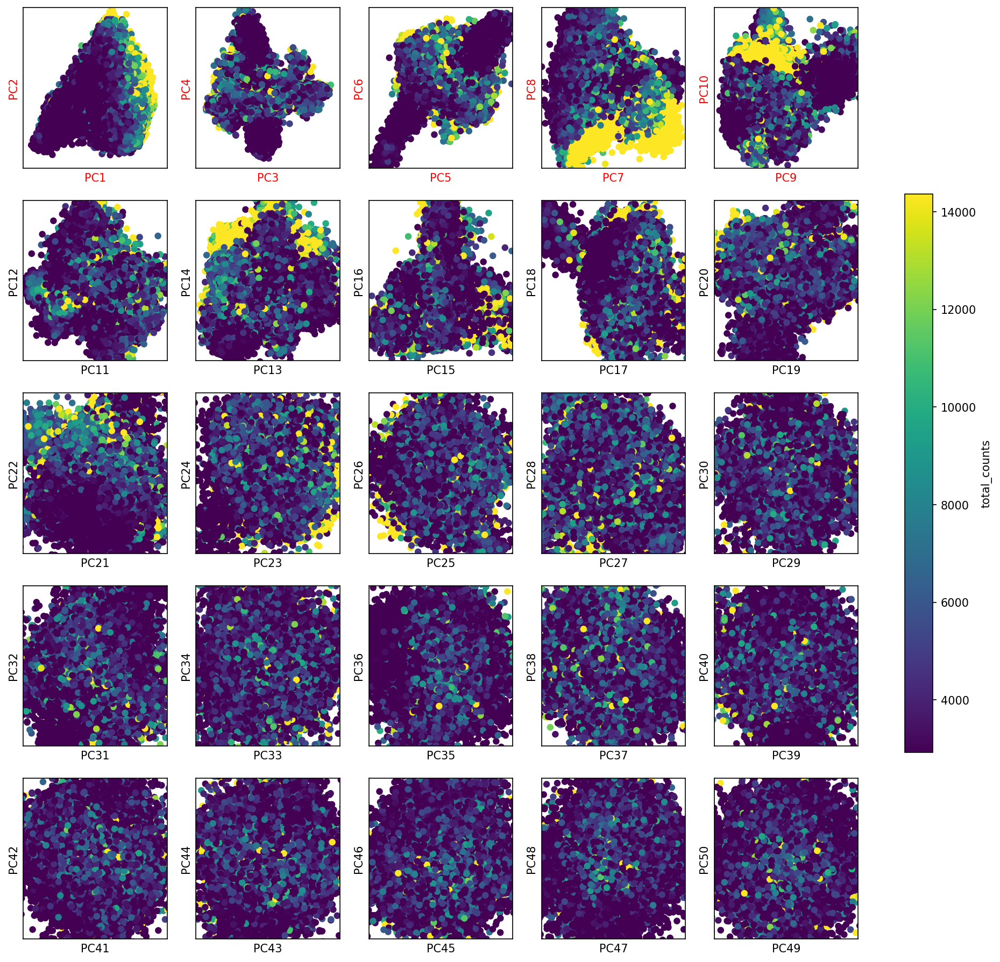

In [8]:
hue = 'total_counts'
fig, axes = plot_decomp_scatters(adata_sc,
                                 n_components=10,
                                 hue=hue,
                                 hue_quantile=(0.25, 0.75),
                                 nrows=5,
                                 ncols=5)


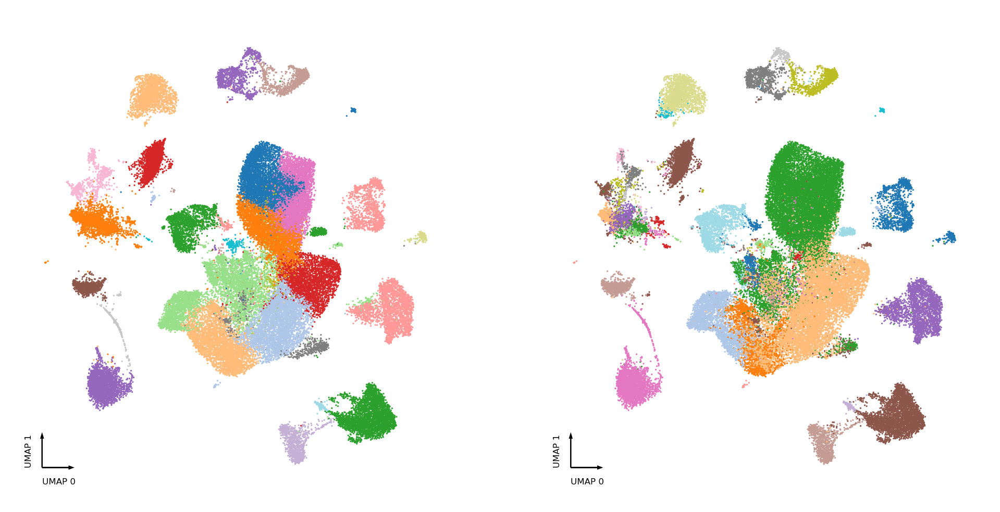

In [9]:
fig, axes = plt.subplots(figsize=(8, 4), dpi=300, ncols=2)
ax = axes[0]
categorical_scatter(ax=ax, data=adata_sc, hue='louvain', palette='tab20')
ax = axes[1]
categorical_scatter(ax=ax, data=adata_sc, hue='pred_mwb', palette='tab20')


In [10]:
df_mc_meta=pd.read_csv('/data2st1/junyi/methlyatlas/mCseq/CEMBA.mC.Metadata/CEMBA.mC.Metadata.csv')

In [11]:
PFC_AMY_subregions = ['MOs','PL.ORB','PL,ACA,ILA','CTXsp,sAMY']
selected_cells = df_mc_meta[(df_mc_meta.SubRegion.isin(PFC_AMY_subregions)) | (df_mc_meta.MajorRegion.isin(["HPF"]))].index
selected_meta = df_mc_meta.loc[selected_cells]

In [12]:
df_umap = pd.read_csv('/data2st1/junyi/methlyatlas/mCseq/CEMBA.mC.Coordinates/CEMBA.mC.Coordinates.csv.gz',index_col=0)

In [13]:
sampled_df = selected_meta.sample(n=20000, random_state=42)  # Setting a random state for reproducibility
selected_df_meta = sampled_df.merge(df_umap,left_on="cell",right_index=True)

In [14]:
selected_df_meta

,cell,mCCCFrac,mCGFrac,mCHFrac,FinalmCReads,DissectionRegion,Plate,Col384,Row384,Slice,...,Class,NeuroTransmitters,mc_all_tsne_0,mc_all_tsne_1,mc_all_umap_0,mc_all_umap_1,mr_tsne_0,mr_tsne_1,mr_tsne_0.1,mr_tsne_1.1
19972,11D_M_1703,0.006305,0.806892,0.028249,1932119.0,RHP-2,CEMBA191031_11D_2,14,2,11,...,IT-ET Glut,Glut,33.730780,11.277561,11.077688,6.562847,25.207360,-29.942732,25.207360,-29.942732
195338,8H_M_147,0.011126,0.855426,0.048629,911562.0,AMY-2,CEMBA200910_8H_4,0,5,8,...,CNU GABA,Gaba-Chol,-9.698537,-35.789867,-0.708369,7.286210,-17.931974,17.953358,-17.931974,17.953358
19830,11D_M_1560,0.004896,0.738517,0.015735,3069027.0,RHP-2,CEMBA191031_11D_2,2,1,11,...,IT-ET Glut,Glut,28.463326,-5.659310,8.616229,5.539936,-7.721038,-30.417410,-7.721038,-30.417410
164806,9H_M_1939,0.007451,0.808317,0.037041,1199230.0,CA-ii,CEMBA190219_9H_2,21,9,9,...,CTX-MGE GABA,Gaba,24.744213,-45.256150,2.790866,12.755568,52.230620,-8.541183,52.230620,-8.541183
164596,9H_M_1712,0.006001,0.759920,0.026240,849767.0,CA-ii,CEMBA190219_9H_2,14,2,9,...,IT-ET Glut,Glut,47.343796,36.719624,7.431166,16.454044,-28.914938,22.415714,-28.914938,22.415714
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199930,7H_M_2003,0.006828,0.819417,0.024433,1425837.0,AMY-1,CEMBA200820_7H_2,17,6,7,...,CNU-HYa GABA,Gaba,-4.243414,-17.316797,1.573159,5.634891,-24.799978,-9.247787,-24.799978,-9.247787
198985,7H_M_955,0.010215,0.778719,0.043511,1246331.0,AMY-1,CEMBA200827_7H_1,8,15,7,...,IT-ET Glut,Glut,30.220680,-7.820685,8.583899,6.567679,62.518272,21.818941,62.518272,21.818941
61449,3B_M_637,0.006320,0.814070,0.028560,1131343.0,MOs-3,CEMBA180312_3B_1,3,15,3,...,NP-CT-L6b Glut,Glut,12.277461,43.838770,12.496676,14.037808,0.342028,65.131660,0.342028,65.131660
239682,13B_M_593,0.006915,0.775317,0.032607,1325886.0,RHP-5,CEMBA201210_13B_2,20,4,13,...,IT-ET Glut,Glut,16.254238,-13.744461,12.992558,2.233200,-19.407684,-76.775140,-19.407684,-76.775140


# Prepare L4 region level methlylation data and load the gene 2k flaking bases

In [15]:
var_dim = 'geneslop2k-vm23'
mcds = MCDS.open('/data2st1/junyi/methlyatlas/mCseq/data.nemoarchive.org/biccn/grant/u19_cemba/ecker/epigenome/cellgroup/mCseq3/mouse/processed/counts/CEMBA.snmC.mcds',
                   obs_dim='cell',var_dim=var_dim,use_obs=selected_df_meta.cell)

In [16]:
mcds

<xarray.MCDS>
Dimensions:                   (cell: 20000, count_type: 2,
                               geneslop2k-vm23: 32208, mc_type: 2)
Coordinates:
  * cell                      (cell) <U15 '10D_M_64' '10D_M_98' ... '11E_M_610'
  * count_type                (count_type) <U3 'mc' 'cov'
  * geneslop2k-vm23           (geneslop2k-vm23) <U18 'ENSMUSG00000051951' ......
    geneslop2k-vm23_chrom     (geneslop2k-vm23) <U5 'chr1' 'chr1' ... 'chrM'
    geneslop2k-vm23_cov_mean  (geneslop2k-vm23) float64 6.313e+03 ... 312.2
    geneslop2k-vm23_end       (geneslop2k-vm23) int64 3673498 3515553 ... 16299
    geneslop2k-vm23_start     (geneslop2k-vm23) int64 3203901 3464587 ... 12145
  * mc_type                   (mc_type) <U3 'CGN' 'CHN'
Data variables:
    geneslop2k-vm23_da        (cell, geneslop2k-vm23, mc_type, count_type) uint16 dask.array<chunksize=(1000, 32208, 1, 1), meta=np.ndarray>
    geneslop2k-vm23_da_frac   (cell, geneslop2k-vm23, mc_type) float32 dask.array<chunksize=(1000, 32208, 1), meta=np.ndarray>
Attributes:
    obs_dim:  cell
    var_dim:  geneslop2k-vm23

In [17]:
gene_meta_path = '/home/junyichen/code/whole_mouse_brain/wmb/files/modified_gencode.vM23.primary_assembly.annotation.gene.flat.tsv.gz'


In [18]:
gene_meta = pd.read_csv(gene_meta_path, index_col='gene_id', sep='\t')


In [19]:
gene_meta.head()

,chrom,source,feature,start,end,score,strand,phase,transcript_id,gene_type,...,transcript_type,transcript_status,transcript_name,exon_number,exon_id,level,gene_version,mgi_id,havana_gene,tag
gene_id,,,,,,,,,,,,,,,,,,,,,
ENSMUSG00000051951,chr1,HAVANA,gene,3205901,3671498,.,-,.,NaN,protein_coding,...,NaN,NaN,NaN,NaN,NaN,2,5,MGI:3528744,OTTMUSG00000026353.2,NaN
ENSMUSG00000089699,chr1,HAVANA,gene,3466587,3513553,.,+,.,NaN,lncRNA,...,NaN,NaN,NaN,NaN,NaN,2,1,MGI:3780162,OTTMUSG00000026352.1,NaN
ENSMUSG00000102331,chr1,HAVANA,gene,3647309,3658904,.,-,.,NaN,lncRNA,...,NaN,NaN,NaN,NaN,NaN,2,1,MGI:5012123,OTTMUSG00000049924.1,NaN
ENSMUSG00000102343,chr1,HAVANA,gene,3905739,3986215,.,-,.,NaN,lncRNA,...,NaN,NaN,NaN,NaN,NaN,2,1,MGI:5610609,OTTMUSG00000049934.1,NaN
ENSMUSG00000025900,chr1,HAVANA,gene,3999557,4409241,.,-,.,NaN,protein_coding,...,NaN,NaN,NaN,NaN,NaN,2,12,MGI:1341105,OTTMUSG00000049985.3,overlapping_locus


In [20]:
import pybedtools

genes_to_skip = set()
chrom_to_remove = ['chrM']


# skip smaller genes mostly covered by a larger gene, e.g., a miRNA within a protein coding gene.
# F=0.9 means > 90% of gene_b is overlapped with gene_a, in this case, we only keep gene_a for DMG test
gene_bed = pybedtools.BedTool.from_dataframe(
    gene_meta.reset_index()[['chrom', 'start', 'end', 'gene_id']])
mapped_bam = gene_bed.map(b=gene_bed, c=4, o='distinct', F=0.9)
for _, (*_, gene_a, gene_b_str) in mapped_bam.to_dataframe().iterrows():
    for gene_b in gene_b_str.split(','):
        if gene_b != gene_a:
            genes_to_skip.add(gene_b)

# remove certain chromosomes
genes_to_skip |= set(gene_meta.index[gene_meta['chrom'].isin(chrom_to_remove)])
use_features = gene_meta.index[~gene_meta.index.isin(genes_to_skip)]
print(f'{use_features.size} features remained')


***** WARNING: File /tmp/pybedtools.4w8d9f25.tmp has inconsistent naming convention for record:
GL456210.1	9124	58882	ENSMUSG00000079800

***** WARNING: File /tmp/pybedtools.4w8d9f25.tmp has inconsistent naming convention for record:
GL456210.1	9124	58882	ENSMUSG00000079800



28457 features remained


Using existing geneslop2k-vm23_cov_mean in MCDS.coords, if this is not desired, delete the existing results by `del mcds.coords["geneslop2k-vm23_cov_mean"]` and recalculate.
27651 features remained


/tmp/ipykernel_3560735/370854858.py:5: FutureWarning: Index.__and__ operating as a set operation is deprecated, in the future this will be a logical operation matching Series.__and__.  Use index.intersection(other) instead.
  use_features &= feature_cov_mean[feature_cov_mean > min_cov].index


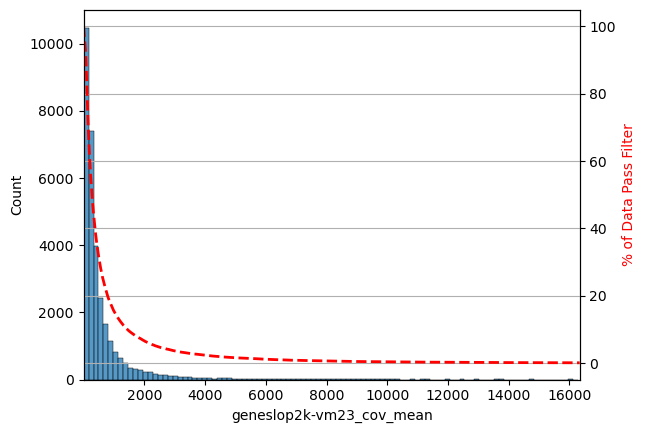

In [21]:
min_cov = 5
mcds.add_feature_cov_mean()

feature_cov_mean = mcds.coords[f'{var_dim}_cov_mean'].to_pandas()
use_features &= feature_cov_mean[feature_cov_mean > min_cov].index

print(f'{use_features.size} features remained')


In [22]:
use_features

Index(['ENSMUSG00000051951', 'ENSMUSG00000102343', 'ENSMUSG00000025900',
       'ENSMUSG00000025902', 'ENSMUSG00000104238', 'ENSMUSG00000104328',
       'ENSMUSG00000033845', 'ENSMUSG00000025903', 'ENSMUSG00000033813',
       'ENSMUSG00000002459',
       ...
       'ENSMUSG00000101533', 'ENSMUSG00000102045', 'ENSMUSG00000100492',
       'ENSMUSG00000099982', 'ENSMUSG00000101402', 'ENSMUSG00000100574',
       'ENSMUSG00000100608', 'ENSMUSG00000102011', 'ENSMUSG00000096178',
       'ENSMUSG00000096768'],
      dtype='object', length=27651)

In [23]:
mcds.filter_feature_by_cov_mean(min_cov=min_cov)


Before cov mean filter: 32208 geneslop2k-vm23
 After cov mean filter: 31425 geneslop2k-vm23 97.6%


<xarray.MCDS>
Dimensions:                   (cell: 20000, count_type: 2,
                               geneslop2k-vm23: 31425, mc_type: 2)
Coordinates:
  * cell                      (cell) <U15 '10D_M_64' '10D_M_98' ... '11E_M_610'
  * count_type                (count_type) <U3 'mc' 'cov'
  * geneslop2k-vm23           (geneslop2k-vm23) <U18 'ENSMUSG00000051951' ......
    geneslop2k-vm23_chrom     (geneslop2k-vm23) <U5 'chr1' 'chr1' ... 'chrM'
    geneslop2k-vm23_cov_mean  (geneslop2k-vm23) float64 6.313e+03 ... 312.2
    geneslop2k-vm23_end       (geneslop2k-vm23) int64 3673498 3515553 ... 16299
    geneslop2k-vm23_start     (geneslop2k-vm23) int64 3203901 3464587 ... 12145
  * mc_type                   (mc_type) <U3 'CGN' 'CHN'
Data variables:
    geneslop2k-vm23_da        (cell, geneslop2k-vm23, mc_type, count_type) uint16 dask.array<chunksize=(1000, 31425, 1, 1), meta=np.ndarray>
    geneslop2k-vm23_da_frac   (cell, geneslop2k-vm23, mc_type) float32 dask.array<chunksize=(1000, 31425, 1), meta=np.ndarray>
Attributes:
    obs_dim:  cell
    var_dim:  geneslop2k-vm23

In [24]:
mcds

<xarray.MCDS>
Dimensions:                   (cell: 20000, count_type: 2,
                               geneslop2k-vm23: 32208, mc_type: 2)
Coordinates:
  * cell                      (cell) <U15 '10D_M_64' '10D_M_98' ... '11E_M_610'
  * count_type                (count_type) <U3 'mc' 'cov'
  * geneslop2k-vm23           (geneslop2k-vm23) <U18 'ENSMUSG00000051951' ......
    geneslop2k-vm23_chrom     (geneslop2k-vm23) <U5 'chr1' 'chr1' ... 'chrM'
    geneslop2k-vm23_cov_mean  (geneslop2k-vm23) float64 6.313e+03 ... 312.2
    geneslop2k-vm23_end       (geneslop2k-vm23) int64 3673498 3515553 ... 16299
    geneslop2k-vm23_start     (geneslop2k-vm23) int64 3203901 3464587 ... 12145
  * mc_type                   (mc_type) <U3 'CGN' 'CHN'
Data variables:
    geneslop2k-vm23_da        (cell, geneslop2k-vm23, mc_type, count_type) uint16 dask.array<chunksize=(1000, 32208, 1, 1), meta=np.ndarray>
    geneslop2k-vm23_da_frac   (cell, geneslop2k-vm23, mc_type) float32 dask.array<chunksize=(1000, 32208, 1), meta=np.ndarray>
Attributes:
    obs_dim:  cell
    var_dim:  geneslop2k-vm23

In [25]:
mcds.add_mc_frac(normalize_per_cell=True, clip_norm_value=10)


In [26]:
mcds

<xarray.MCDS>
Dimensions:                   (cell: 20000, count_type: 2,
                               geneslop2k-vm23: 32208, mc_type: 2)
Coordinates:
  * cell                      (cell) <U15 '10D_M_64' '10D_M_98' ... '11E_M_610'
  * count_type                (count_type) <U3 'mc' 'cov'
  * geneslop2k-vm23           (geneslop2k-vm23) <U18 'ENSMUSG00000051951' ......
    geneslop2k-vm23_chrom     (geneslop2k-vm23) <U5 'chr1' 'chr1' ... 'chrM'
    geneslop2k-vm23_cov_mean  (geneslop2k-vm23) float64 6.313e+03 ... 312.2
    geneslop2k-vm23_end       (geneslop2k-vm23) int64 3673498 3515553 ... 16299
    geneslop2k-vm23_start     (geneslop2k-vm23) int64 3203901 3464587 ... 12145
  * mc_type                   (mc_type) <U3 'CGN' 'CHN'
Data variables:
    geneslop2k-vm23_da        (cell, geneslop2k-vm23, mc_type, count_type) uint16 dask.array<chunksize=(1000, 32208, 1, 1), meta=np.ndarray>
    geneslop2k-vm23_da_frac   (cell, geneslop2k-vm23, mc_type) float64 dask.array<chunksize=(1000, 32208, 1), meta=np.ndarray>
Attributes:
    obs_dim:  cell
    var_dim:  geneslop2k-vm23

In [27]:
mcds = mcds[['geneslop2k-vm23_da_frac']]
mcds['geneslop2k-vm23_da_frac'] = mcds['geneslop2k-vm23_da_frac'].astype('float32')


In [28]:
mcds

<xarray.MCDS>
Dimensions:                   (cell: 20000, geneslop2k-vm23: 32208, mc_type: 2)
Coordinates:
  * cell                      (cell) <U15 '10D_M_64' '10D_M_98' ... '11E_M_610'
  * geneslop2k-vm23           (geneslop2k-vm23) <U18 'ENSMUSG00000051951' ......
    geneslop2k-vm23_chrom     (geneslop2k-vm23) <U5 'chr1' 'chr1' ... 'chrM'
    geneslop2k-vm23_cov_mean  (geneslop2k-vm23) float64 6.313e+03 ... 312.2
    geneslop2k-vm23_end       (geneslop2k-vm23) int64 3673498 3515553 ... 16299
    geneslop2k-vm23_start     (geneslop2k-vm23) int64 3203901 3464587 ... 12145
  * mc_type                   (mc_type) <U3 'CGN' 'CHN'
Data variables:
    geneslop2k-vm23_da_frac   (cell, geneslop2k-vm23, mc_type) float32 dask.array<chunksize=(1000, 32208, 1), meta=np.ndarray>
Attributes:
    obs_dim:  cell
    var_dim:  geneslop2k-vm23

In [29]:
mcds

<xarray.MCDS>
Dimensions:                   (cell: 20000, geneslop2k-vm23: 32208, mc_type: 2)
Coordinates:
  * cell                      (cell) <U15 '10D_M_64' '10D_M_98' ... '11E_M_610'
  * geneslop2k-vm23           (geneslop2k-vm23) <U18 'ENSMUSG00000051951' ......
    geneslop2k-vm23_chrom     (geneslop2k-vm23) <U5 'chr1' 'chr1' ... 'chrM'
    geneslop2k-vm23_cov_mean  (geneslop2k-vm23) float64 6.313e+03 ... 312.2
    geneslop2k-vm23_end       (geneslop2k-vm23) int64 3673498 3515553 ... 16299
    geneslop2k-vm23_start     (geneslop2k-vm23) int64 3203901 3464587 ... 12145
  * mc_type                   (mc_type) <U3 'CGN' 'CHN'
Data variables:
    geneslop2k-vm23_da_frac   (cell, geneslop2k-vm23, mc_type) float32 dask.array<chunksize=(1000, 32208, 1), meta=np.ndarray>
Attributes:
    obs_dim:  cell
    var_dim:  geneslop2k-vm23

In [30]:
mcds.write_dataset('output/geneslop2k-vm23_frac.mcds', var_dims=['geneslop2k-vm23'],mode='w')


Saving geneslop2k-vm23
Saving chunk 0: 0 - 2000


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


Saving chunk 1: 2000 - 4000


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


Saving chunk 2: 4000 - 6000


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


Saving chunk 3: 6000 - 8000


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


Saving chunk 4: 8000 - 10000


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


Saving chunk 5: 10000 - 12000


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


Saving chunk 6: 12000 - 14000


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


Saving chunk 7: 14000 - 16000


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


Saving chunk 8: 16000 - 18000


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


Saving chunk 9: 18000 - 20000


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


In [31]:
use_gene_meta = gene_meta.loc[use_features]
use_gene_meta.to_csv('output/GeneMetadata.csv.gz')


In [32]:
mcg = mcds.get_adata(mc_type='CGN',var_dim='geneslop2k-vm23',obs_dim='cell')

select_hvf is True, but no highly variable feature results found, use all features instead.


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


In [33]:
mcg


AnnData object with n_obs × n_vars = 20000 × 32208
    var: 'chrom', 'cov_mean', 'end', 'start'

In [34]:
mcg.obs

""
cell
10D_M_64
10D_M_98
10D_M_111
10D_M_263
10D_M_265
...
11E_M_2022
11D_M_2242
12E_M_2875


In [35]:
mch = mcds.get_adata(mc_type='CHN',var_dim='geneslop2k-vm23',obs_dim='cell')

select_hvf is True, but no highly variable feature results found, use all features instead.


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


In [36]:
mch

AnnData object with n_obs × n_vars = 20000 × 32208
    var: 'chrom', 'cov_mean', 'end', 'start'

# Prepare L4 region level metadata

In [37]:
meta_data = df_mc_meta

In [38]:
meta_data.head()

,cell,mCCCFrac,mCGFrac,mCHFrac,FinalmCReads,DissectionRegion,Plate,Col384,Row384,Slice,...,InputReads,PassBasicQC,PlateNormCov,CEMBARegion,MajorRegion,SubRegion,CellGroup,SubClass,Class,NeuroTransmitters
0,10A_M_1,0.008874,0.819390,0.036336,1073981.0,RSP-4,CEMBA190423_10A_1,0,1,10,...,2252674,True,0.834409,10A,Isocortex,RSP,c18_c4_c1_c1_r0,L6b CTX Glut,NP-CT-L6b Glut,Glut
1,10A_M_100,0.007105,0.762382,0.019705,1108484.0,RSP-4,CEMBA190423_10A_2,0,3,10,...,2549478,True,0.842048,10A,Isocortex,RSP,c24_c0_c0_c0_r2,L2/3 IT RSP Glut,IT-ET Glut,Glut
2,10A_M_1000,0.006450,0.744689,0.016373,1443814.0,RSP-4,CEMBA190423_10A_4,7,5,10,...,3342484,True,1.031215,10A,Isocortex,RSP,c24_c0_c0_c0_r2,L2/3 IT RSP Glut,IT-ET Glut,Glut
3,10A_M_1001,0.007433,0.780743,0.029361,1372174.0,RSP-4,CEMBA190423_10A_3,8,4,10,...,3220214,True,0.942444,10A,Isocortex,RSP,c2_c3_c4_c2_r0,L6 CT CTX Glut,NP-CT-L6b Glut,Glut
4,10A_M_1002,0.006215,0.741165,0.018129,1650777.0,RSP-4,CEMBA190423_10A_3,8,5,10,...,3871980,True,1.133796,10A,Isocortex,RSP,c24_c0_c0_c0_r2,L2/3 IT RSP Glut,IT-ET Glut,Glut


In [39]:
meta_data.columns

Index(['cell', 'mCCCFrac', 'mCGFrac', 'mCHFrac', 'FinalmCReads',
       'DissectionRegion', 'Plate', 'Col384', 'Row384', 'Slice', 'Sample',
       'Technology', 'InputReads', 'PassBasicQC', 'PlateNormCov',
       'CEMBARegion', 'MajorRegion', 'SubRegion', 'CellGroup', 'SubClass',
       'Class', 'NeuroTransmitters'],
      dtype='object')

# Group metat for cell group level
- some are median 
- some are sum

In [40]:
df_mc_meta

,cell,mCCCFrac,mCGFrac,mCHFrac,FinalmCReads,DissectionRegion,Plate,Col384,Row384,Slice,...,InputReads,PassBasicQC,PlateNormCov,CEMBARegion,MajorRegion,SubRegion,CellGroup,SubClass,Class,NeuroTransmitters
0,10A_M_1,0.008874,0.819390,0.036336,1073981.0,RSP-4,CEMBA190423_10A_1,0,1,10,...,2252674,True,0.834409,10A,Isocortex,RSP,c18_c4_c1_c1_r0,L6b CTX Glut,NP-CT-L6b Glut,Glut
1,10A_M_100,0.007105,0.762382,0.019705,1108484.0,RSP-4,CEMBA190423_10A_2,0,3,10,...,2549478,True,0.842048,10A,Isocortex,RSP,c24_c0_c0_c0_r2,L2/3 IT RSP Glut,IT-ET Glut,Glut
2,10A_M_1000,0.006450,0.744689,0.016373,1443814.0,RSP-4,CEMBA190423_10A_4,7,5,10,...,3342484,True,1.031215,10A,Isocortex,RSP,c24_c0_c0_c0_r2,L2/3 IT RSP Glut,IT-ET Glut,Glut
3,10A_M_1001,0.007433,0.780743,0.029361,1372174.0,RSP-4,CEMBA190423_10A_3,8,4,10,...,3220214,True,0.942444,10A,Isocortex,RSP,c2_c3_c4_c2_r0,L6 CT CTX Glut,NP-CT-L6b Glut,Glut
4,10A_M_1002,0.006215,0.741165,0.018129,1650777.0,RSP-4,CEMBA190423_10A_3,8,5,10,...,3871980,True,1.133796,10A,Isocortex,RSP,c24_c0_c0_c0_r2,L2/3 IT RSP Glut,IT-ET Glut,Glut
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
301621,17A_M_3051,0.007412,0.747842,0.018610,1559491.0,CB-4,CEMBA210812_17A_4,1,14,17,...,4589584,True,1.090938,17A,CB,CBX,c21_c5_c2_c0_r1,CBX Purkinje Gaba,CB GABA,Gaba
301622,17A_M_3052,0.008806,0.830814,0.043916,1219087.0,CB-4,CEMBA210812_17A_4,0,15,17,...,3510150,True,0.852810,17A,CB,CBX,c36_c1_c0_c0_r1,CBX Golgi Gly-Gaba,CB GABA,Gly-Gaba
301623,17A_M_3053,0.006352,0.768759,0.023178,1723321.0,CB-4,CEMBA210812_17A_4,12,15,17,...,4903466,True,1.205545,17A,CB,CBX,c21_c5_c0_c0_r1,CBX Purkinje Gaba,CB GABA,Gaba
301624,17A_M_3054,0.006006,0.755818,0.018815,1673963.0,CB-4,CEMBA210812_17A_4,13,15,17,...,4773312,True,1.171017,17A,CB,CBX,c21_c0_c2_c0_r1,CBX Purkinje Gaba,CB GABA,Gaba


In [41]:
selected_df_meta

,cell,mCCCFrac,mCGFrac,mCHFrac,FinalmCReads,DissectionRegion,Plate,Col384,Row384,Slice,...,Class,NeuroTransmitters,mc_all_tsne_0,mc_all_tsne_1,mc_all_umap_0,mc_all_umap_1,mr_tsne_0,mr_tsne_1,mr_tsne_0.1,mr_tsne_1.1
19972,11D_M_1703,0.006305,0.806892,0.028249,1932119.0,RHP-2,CEMBA191031_11D_2,14,2,11,...,IT-ET Glut,Glut,33.730780,11.277561,11.077688,6.562847,25.207360,-29.942732,25.207360,-29.942732
195338,8H_M_147,0.011126,0.855426,0.048629,911562.0,AMY-2,CEMBA200910_8H_4,0,5,8,...,CNU GABA,Gaba-Chol,-9.698537,-35.789867,-0.708369,7.286210,-17.931974,17.953358,-17.931974,17.953358
19830,11D_M_1560,0.004896,0.738517,0.015735,3069027.0,RHP-2,CEMBA191031_11D_2,2,1,11,...,IT-ET Glut,Glut,28.463326,-5.659310,8.616229,5.539936,-7.721038,-30.417410,-7.721038,-30.417410
164806,9H_M_1939,0.007451,0.808317,0.037041,1199230.0,CA-ii,CEMBA190219_9H_2,21,9,9,...,CTX-MGE GABA,Gaba,24.744213,-45.256150,2.790866,12.755568,52.230620,-8.541183,52.230620,-8.541183
164596,9H_M_1712,0.006001,0.759920,0.026240,849767.0,CA-ii,CEMBA190219_9H_2,14,2,9,...,IT-ET Glut,Glut,47.343796,36.719624,7.431166,16.454044,-28.914938,22.415714,-28.914938,22.415714
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199930,7H_M_2003,0.006828,0.819417,0.024433,1425837.0,AMY-1,CEMBA200820_7H_2,17,6,7,...,CNU-HYa GABA,Gaba,-4.243414,-17.316797,1.573159,5.634891,-24.799978,-9.247787,-24.799978,-9.247787
198985,7H_M_955,0.010215,0.778719,0.043511,1246331.0,AMY-1,CEMBA200827_7H_1,8,15,7,...,IT-ET Glut,Glut,30.220680,-7.820685,8.583899,6.567679,62.518272,21.818941,62.518272,21.818941
61449,3B_M_637,0.006320,0.814070,0.028560,1131343.0,MOs-3,CEMBA180312_3B_1,3,15,3,...,NP-CT-L6b Glut,Glut,12.277461,43.838770,12.496676,14.037808,0.342028,65.131660,0.342028,65.131660
239682,13B_M_593,0.006915,0.775317,0.032607,1325886.0,RHP-5,CEMBA201210_13B_2,20,4,13,...,IT-ET Glut,Glut,16.254238,-13.744461,12.992558,2.233200,-19.407684,-76.775140,-19.407684,-76.775140


In [42]:
mcg.obs

""
cell
10D_M_64
10D_M_98
10D_M_111
10D_M_263
10D_M_265
...
11E_M_2022
11D_M_2242
12E_M_2875


In [43]:
mcg.obs = mcg.obs.merge(selected_df_meta,left_index=True,right_on='cell')    

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:788: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [228008, 228041, 228052, 228193, 228195]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


In [44]:
mcg.obs

,cell,mCCCFrac,mCGFrac,mCHFrac,FinalmCReads,DissectionRegion,Plate,Col384,Row384,Slice,...,Class,NeuroTransmitters,mc_all_tsne_0,mc_all_tsne_1,mc_all_umap_0,mc_all_umap_1,mr_tsne_0,mr_tsne_1,mr_tsne_0.1,mr_tsne_1.1
228008,10D_M_64,0.006438,0.765780,0.022757,1491961.0,RHP-1,CEMBA201203_10D_5,14,0,10,...,IT-ET Glut,Glut,55.077990,-17.641394,18.129213,1.519717,13.998060,-16.327232,13.998060,-16.327232
228041,10D_M_98,0.007231,0.761465,0.025830,1004956.0,RHP-1,CEMBA201203_10D_5,2,8,10,...,IT-ET Glut,Glut,55.956280,-16.668024,17.722948,2.063337,14.014369,-17.151241,14.014369,-17.151241
228052,10D_M_111,0.006220,0.763170,0.022399,1118411.0,RHP-1,CEMBA201203_10D_5,15,12,10,...,IT-ET Glut,Glut,55.376200,-17.724155,18.237843,1.559935,14.028082,-16.332813,14.028082,-16.332813
228193,10D_M_263,0.007939,0.762790,0.025978,1538405.0,RHP-1,CEMBA201203_10D_5,20,2,10,...,IT-ET Glut,Glut,54.280155,-16.852920,17.527954,1.093661,12.971472,-16.250986,12.971472,-16.250986
228195,10D_M_265,0.006589,0.755702,0.021547,1164056.0,RHP-1,CEMBA201203_10D_5,8,2,10,...,IT-ET Glut,Glut,55.164460,-17.910550,18.236850,1.520383,14.134044,-16.185085,14.134044,-16.185085
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22750,11E_M_2022,0.003053,0.707928,0.005766,1486002.0,CA-iv,CEMBA190305_11E_1,22,11,11,...,Vascular,NN,-44.669327,41.399033,1.986604,-9.597748,49.544670,26.041739,49.544670,26.041739
20491,11D_M_2242,0.003742,0.730572,0.007803,1939897.0,RHP-2,CEMBA191031_11D_1,6,15,11,...,Vascular,NN,-44.848278,43.524857,1.716967,-9.421869,49.628970,24.848055,49.628970,24.848055
195022,12E_M_2875,0.005784,0.737786,0.010537,1041928.0,RHP-4,CEMBA200827_12E_4,22,0,12,...,Vascular,NN,-43.443253,42.174280,1.990178,-9.429855,49.956184,26.040808,49.956184,26.040808
152318,8J_M_402,0.003951,0.760012,0.009388,1648378.0,DG-1,CEMBA190711_8J_2,22,8,8,...,Vascular,NN,-45.452670,43.692440,1.588859,-9.512807,49.885017,24.455810,49.885017,24.455810


In [45]:
mcg.obsm['X_umap'] = mcg.obs[['mc_all_umap_0', 'mc_all_umap_1']].values


In [46]:
mch.obs = mch.obs.merge(selected_df_meta,left_index=True,right_on='cell')  

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:788: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [228008, 228041, 228052, 228193, 228195]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


In [47]:
mch.obsm['X_umap'] = mch.obs[['mc_all_umap_0', 'mc_all_umap_1']].values


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


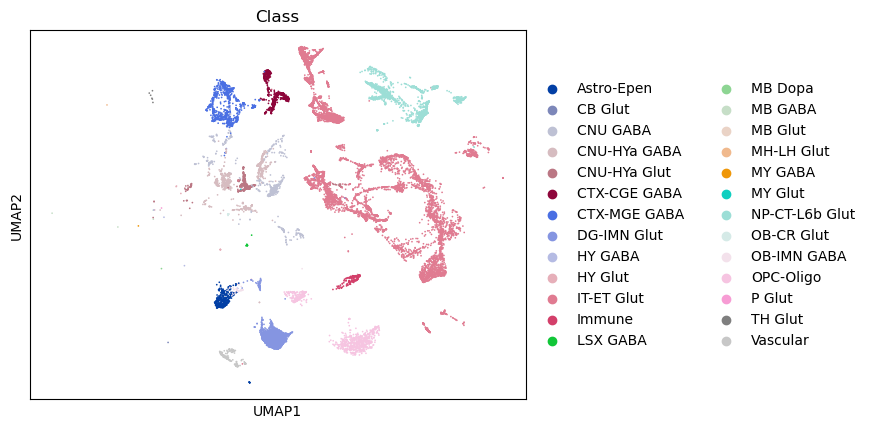

In [48]:
sc.pl.umap(mcg, color=['Class'], ncols=2)

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


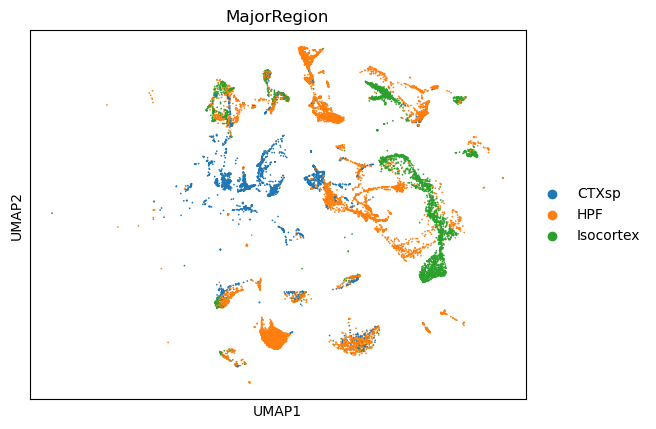

In [49]:
sc.pl.umap(mch, color=['MajorRegion'], ncols=2)

# Prepare the mcds file will 100k bin 

In [50]:
var_dim = 'chrom100k'
mcds_bin = MCDS.open('/data2st1/junyi/methlyatlas/mCseq/data.nemoarchive.org/biccn/grant/u19_cemba/ecker/epigenome/cellgroup/mCseq3/mouse/processed/counts/CEMBA.snmC.mcds',
                   obs_dim='cell',var_dim=var_dim,use_obs=selected_df_meta.cell)

total_feature = mcds_bin.get_index(var_dim).size
mcds_bin


<xarray.MCDS>
Dimensions:             (cell: 20000, chrom100k: 27269, count_type: 2,
                         mc_type: 2)
Coordinates:
  * cell                (cell) <U15 '10D_M_64' '10D_M_98' ... '11E_M_610'
  * chrom100k           (chrom100k) <U10 'chr1_0' 'chr1_1' ... 'chrY_917'
    chrom100k_chrom     (chrom100k) <U5 'chr1' 'chr1' 'chr1' ... 'chrY' 'chrY'
    chrom100k_cov_mean  (chrom100k) float64 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    chrom100k_end       (chrom100k) int64 100000 200000 ... 91700000 91744698
    chrom100k_start     (chrom100k) int64 0 100000 200000 ... 91600000 91700000
  * count_type          (count_type) <U3 'mc' 'cov'
  * mc_type             (mc_type) <U3 'CHN' 'CGN'
Data variables:
    chrom100k_da        (cell, chrom100k, mc_type, count_type) uint16 dask.array<chunksize=(1000, 27269, 1, 1), meta=np.ndarray>
    chrom100k_da_frac   (cell, chrom100k, mc_type) float16 dask.array<chunksize=(1000, 27269, 1), meta=np.ndarray>
Attributes:
    obs_dim:  cell
    var_dim:  chrom100k

In [51]:
selected_df_meta.set_index('cell',inplace=True)

In [52]:
mcds_bin.add_cell_metadata(selected_df_meta)


Using existing chrom100k_cov_mean in MCDS.coords, if this is not desired, delete the existing results by `del mcds.coords["chrom100k_cov_mean"]` and recalculate.


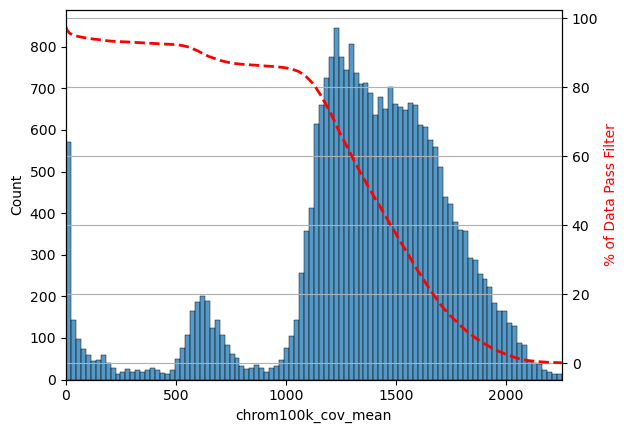

In [53]:
mcds_bin.add_feature_cov_mean(var_dim=var_dim)


In [54]:

# feature cov cutoffs
min_cov = 500
max_cov = 3000
black_list_fraction = 0.2
black_list_path = mm10.ENCODE_BLACKLIST_PATH
exclude_chromosome = ['chrM']
# HVF
mch_pattern = 'CHN'
mcg_pattern = 'CGN'
n_top_feature = 20000

# PC cutoff
pc_cutoff = 0.1

# KNN
knn = -1  # -1 means auto determine

# Leiden
resolution = 1


# filter by coverage - based on the distribution above
mcds_bin = mcds_bin.filter_feature_by_cov_mean(
    min_cov=min_cov,  # minimum coverage
    max_cov=max_cov  # maximum coverage
)

# remove blacklist regions
mcds_bin = mcds_bin.remove_black_list_region(
    black_list_path=black_list_path,
    f=black_list_fraction  # Features having overlap > f with any black list region will be removed.
)

# remove chromosomes
mcds_bin = mcds_bin.remove_chromosome(exclude_chromosome)

Before cov mean filter: 27269 chrom100k
 After cov mean filter: 25187 chrom100k 92.4%
1166 chrom100k features removed due to overlapping (bedtools intersect -f 0.2) with black list regions.
1 chrom100k features in ['chrM'] removed.


In [55]:
mcds_bin

<xarray.MCDS>
Dimensions:                 (cell: 20000, chrom100k: 24032, count_type: 2,
                             mc_type: 2)
Coordinates: (12/37)
  * cell                    (cell) object '10D_M_64' '10D_M_98' ... '11E_M_610'
  * chrom100k               (chrom100k) <U10 'chr1_30' 'chr1_31' ... 'chrY_99'
    chrom100k_chrom         (chrom100k) <U5 'chr1' 'chr1' ... 'chrY' 'chrY'
    chrom100k_cov_mean      (chrom100k) float64 1.237e+03 1.223e+03 ... 530.9
    chrom100k_end           (chrom100k) int64 3100000 3200000 ... 10000000
    chrom100k_start         (chrom100k) int64 3000000 3100000 ... 9900000
    ...                      ...
    cell_mc_all_umap_0      (cell) float64 18.13 17.72 18.24 ... 1.589 -2.653
    cell_mc_all_umap_1      (cell) float64 1.52 2.063 1.56 ... -9.513 -8.794
    cell_mr_tsne_0          (cell) float64 14.0 14.01 14.03 ... 49.89 33.34
    cell_mr_tsne_1          (cell) float64 -16.33 -17.15 -16.33 ... 24.46 10.16
    cell_mr_tsne_0.1        (cell) float64 14.0 14.01 14.03 ... 49.89 33.34
    cell_mr_tsne_1.1        (cell) float64 -16.33 -17.15 -16.33 ... 24.46 10.16
Data variables:
    chrom100k_da            (cell, chrom100k, mc_type, count_type) uint16 dask.array<chunksize=(1000, 24032, 1, 1), meta=np.ndarray>
    chrom100k_da_frac       (cell, chrom100k, mc_type) float16 dask.array<chunksize=(1000, 24032, 1), meta=np.ndarray>
Attributes:
    obs_dim:  cell
    var_dim:  chrom100k

In [56]:
load = True
mcds_bin.add_mc_frac(
normalize_per_cell=True,  # after calculating mC frac, per cell normalize the matrix
    clip_norm_value=10  # clip outlier values above 10 to 10
)
obs_dim = 'cell'

# load only the mC fraction matrix into memory so following steps is faster
# Only load into memory when your memory size is enough to handle your dataset
if load and (mcds_bin.get_index(obs_dim).size < 20000):
    mcds_bin[f'{var_dim}_da_frac'].load()


In [57]:
mch_bin_hvf = mcds_bin.calculate_hvf_svr(var_dim=var_dim,
                                 mc_type=mcg_pattern,
                                 n_top_feature=n_top_feature,
                                 plot=True)

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


Fitting SVR with gamma 0.0416, predicting feature dispersion using mc_frac_mean and cov_mean.
Total Feature Number:     24032
Highly Variable Feature:  20000 (83.2%)


In [58]:
mcg_bin_adata = mcds_bin.get_adata(mc_type=mcg_pattern,
                           var_dim=var_dim,
                           select_hvf=True)
mcg_bin_adata


AnnData object with n_obs × n_vars = 20000 × 20000
    obs: 'mCCCFrac', 'mCGFrac', 'mCHFrac', 'FinalmCReads', 'DissectionRegion', 'Plate', 'Col384', 'Row384', 'Slice', 'Sample', 'Technology', 'InputReads', 'PassBasicQC', 'PlateNormCov', 'CEMBARegion', 'MajorRegion', 'SubRegion', 'CellGroup', 'SubClass', 'Class', 'NeuroTransmitters', 'mc_all_tsne_0', 'mc_all_tsne_1', 'mc_all_umap_0', 'mc_all_umap_1', 'mr_tsne_0', 'mr_tsne_1', 'mr_tsne_0.1', 'mr_tsne_1.1'
    var: 'chrom', 'cov_mean', 'end', 'start', 'CGN_mean', 'CGN_dispersion', 'CGN_cov', 'CGN_score', 'CGN_feature_select'

In [59]:
mcg_bin_adata.obs.head()

,mCCCFrac,mCGFrac,mCHFrac,FinalmCReads,DissectionRegion,Plate,Col384,Row384,Slice,Sample,...,Class,NeuroTransmitters,mc_all_tsne_0,mc_all_tsne_1,mc_all_umap_0,mc_all_umap_1,mr_tsne_0,mr_tsne_1,mr_tsne_0.1,mr_tsne_1.1
cell,,,,,,,,,,,,,,,,,,,,,
10D_M_64,0.006438,0.765780,0.022757,1491961.0,RHP-1,CEMBA201203_10D_5,14,0,10,10D_201203,...,IT-ET Glut,Glut,55.077990,-17.641394,18.129213,1.519717,13.998060,-16.327232,13.998060,-16.327232
10D_M_98,0.007231,0.761465,0.025830,1004956.0,RHP-1,CEMBA201203_10D_5,2,8,10,10D_201203,...,IT-ET Glut,Glut,55.956280,-16.668024,17.722948,2.063337,14.014369,-17.151241,14.014369,-17.151241
10D_M_111,0.006220,0.763170,0.022399,1118411.0,RHP-1,CEMBA201203_10D_5,15,12,10,10D_201203,...,IT-ET Glut,Glut,55.376200,-17.724155,18.237843,1.559935,14.028082,-16.332813,14.028082,-16.332813
10D_M_263,0.007939,0.762790,0.025978,1538405.0,RHP-1,CEMBA201203_10D_5,20,2,10,10D_201203,...,IT-ET Glut,Glut,54.280155,-16.852920,17.527954,1.093661,12.971472,-16.250986,12.971472,-16.250986
10D_M_265,0.006589,0.755702,0.021547,1164056.0,RHP-1,CEMBA201203_10D_5,8,2,10,10D_201203,...,IT-ET Glut,Glut,55.164460,-17.910550,18.236850,1.520383,14.134044,-16.185085,14.134044,-16.185085


In [60]:
from ALLCools.clustering import tsne, significant_pc_test, log_scale
from ALLCools.plot import *

In [61]:
mcg_bin_adata

AnnData object with n_obs × n_vars = 20000 × 20000
    obs: 'mCCCFrac', 'mCGFrac', 'mCHFrac', 'FinalmCReads', 'DissectionRegion', 'Plate', 'Col384', 'Row384', 'Slice', 'Sample', 'Technology', 'InputReads', 'PassBasicQC', 'PlateNormCov', 'CEMBARegion', 'MajorRegion', 'SubRegion', 'CellGroup', 'SubClass', 'Class', 'NeuroTransmitters', 'mc_all_tsne_0', 'mc_all_tsne_1', 'mc_all_umap_0', 'mc_all_umap_1', 'mr_tsne_0', 'mr_tsne_1', 'mr_tsne_0.1', 'mr_tsne_1.1'
    var: 'chrom', 'cov_mean', 'end', 'start', 'CGN_mean', 'CGN_dispersion', 'CGN_cov', 'CGN_score', 'CGN_feature_select'

In [62]:
log_scale(mcg_bin_adata)


StandardScaler(with_mean=False)

45 components passed P cutoff of 0.1.
Changing adata.obsm['X_pca'] from shape (20000, 50) to (20000, 45)
Red axis labels are used PCs


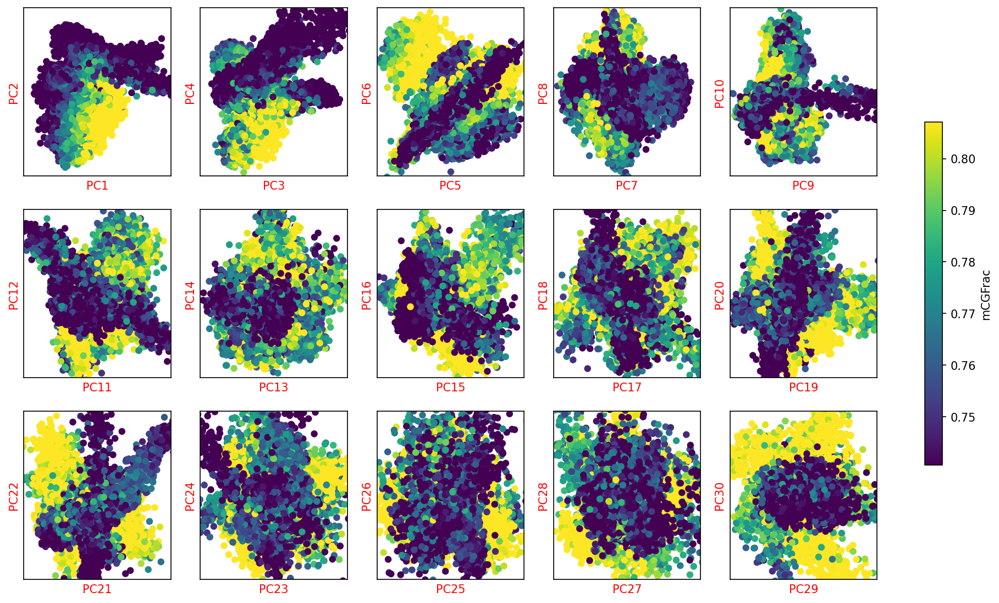

In [63]:
mcg_col_name = 'mCGFrac'  # Name may change

sc.tl.pca(mcg_bin_adata)
cg_n_components = significant_pc_test(mcg_bin_adata)
fig, axes = plot_decomp_scatters(mcg_bin_adata,
                                 n_components=cg_n_components,
                                 hue=mcg_col_name,
                                 hue_quantile=(0.25, 0.75),
                                 nrows=3,
                                 ncols=5)

In [64]:
mch_hvf = mcds_bin.calculate_hvf_svr(var_dim=var_dim,
                                 mc_type=mch_pattern,
                                 n_top_feature=n_top_feature,
                                 plot=True)


Fitting SVR with gamma 0.0416, predicting feature dispersion using mc_frac_mean and cov_mean.
Total Feature Number:     24032
Highly Variable Feature:  20000 (83.2%)


In [65]:
mch_bin_adata = mcds_bin.get_adata(mc_type=mch_pattern,
                           var_dim=var_dim,
                           select_hvf=True)
mch_bin_adata


AnnData object with n_obs × n_vars = 20000 × 20000
    obs: 'mCCCFrac', 'mCGFrac', 'mCHFrac', 'FinalmCReads', 'DissectionRegion', 'Plate', 'Col384', 'Row384', 'Slice', 'Sample', 'Technology', 'InputReads', 'PassBasicQC', 'PlateNormCov', 'CEMBARegion', 'MajorRegion', 'SubRegion', 'CellGroup', 'SubClass', 'Class', 'NeuroTransmitters', 'mc_all_tsne_0', 'mc_all_tsne_1', 'mc_all_umap_0', 'mc_all_umap_1', 'mr_tsne_0', 'mr_tsne_1', 'mr_tsne_0.1', 'mr_tsne_1.1'
    var: 'chrom', 'cov_mean', 'end', 'start', 'CGN_mean', 'CGN_dispersion', 'CGN_cov', 'CGN_score', 'CGN_feature_select', 'CHN_mean', 'CHN_dispersion', 'CHN_cov', 'CHN_score', 'CHN_feature_select'

In [66]:
mch_bin_adata

AnnData object with n_obs × n_vars = 20000 × 20000
    obs: 'mCCCFrac', 'mCGFrac', 'mCHFrac', 'FinalmCReads', 'DissectionRegion', 'Plate', 'Col384', 'Row384', 'Slice', 'Sample', 'Technology', 'InputReads', 'PassBasicQC', 'PlateNormCov', 'CEMBARegion', 'MajorRegion', 'SubRegion', 'CellGroup', 'SubClass', 'Class', 'NeuroTransmitters', 'mc_all_tsne_0', 'mc_all_tsne_1', 'mc_all_umap_0', 'mc_all_umap_1', 'mr_tsne_0', 'mr_tsne_1', 'mr_tsne_0.1', 'mr_tsne_1.1'
    var: 'chrom', 'cov_mean', 'end', 'start', 'CGN_mean', 'CGN_dispersion', 'CGN_cov', 'CGN_score', 'CGN_feature_select', 'CHN_mean', 'CHN_dispersion', 'CHN_cov', 'CHN_score', 'CHN_feature_select'

50 components passed P cutoff of 0.1.
Changing adata.obsm['X_pca'] from shape (20000, 50) to (20000, 50)
Red axis labels are used PCs


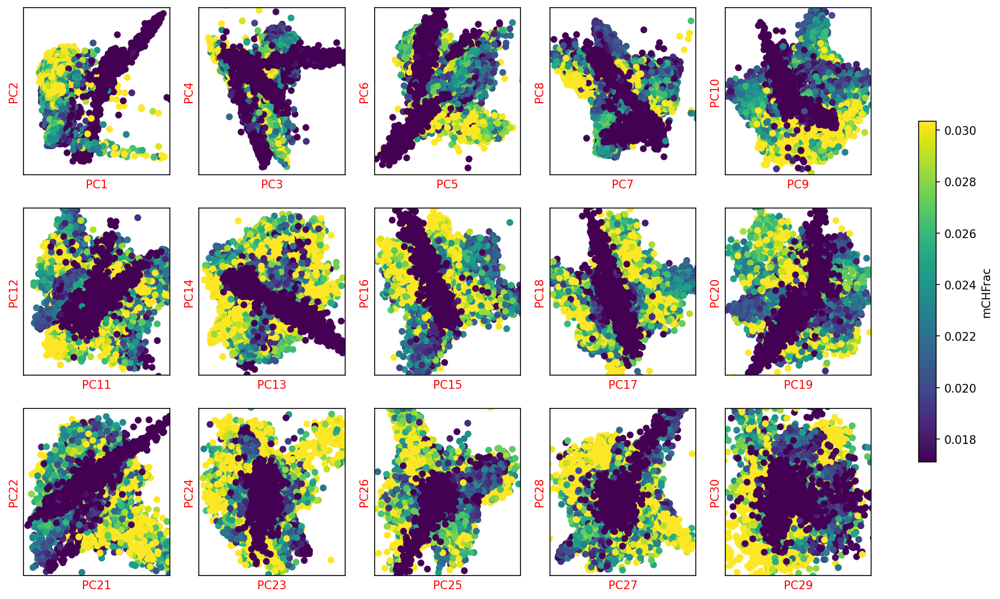

In [67]:
mch_col_name = "mCHFrac"
sc.tl.pca(mch_bin_adata)
ch_n_components = significant_pc_test(mch_bin_adata)
fig, axes = plot_decomp_scatters(mch_bin_adata,
                                 n_components=ch_n_components,
                                 hue=mch_col_name,
                                 hue_quantile=(0.25, 0.75),
                                 nrows=3,
                                 ncols=5)

In [68]:
import numpy as np
ch_pcs = mch_bin_adata.obsm['X_pca'][:, :ch_n_components]
cg_pcs = mcg_bin_adata.obsm['X_pca'][:, :cg_n_components]

cg_pcs = cg_pcs / cg_pcs.std()
ch_pcs = ch_pcs / ch_pcs.std()

# total_pcs
total_pcs = np.hstack([ch_pcs, cg_pcs])

# make a copy of adata, add new pcs
# this is suboptimal, will change this when adata can combine layer and X in the future
adata_merged = mch_bin_adata.copy()
adata_merged.obsm['X_pca'] = total_pcs


In [69]:
adata_merged

AnnData object with n_obs × n_vars = 20000 × 20000
    obs: 'mCCCFrac', 'mCGFrac', 'mCHFrac', 'FinalmCReads', 'DissectionRegion', 'Plate', 'Col384', 'Row384', 'Slice', 'Sample', 'Technology', 'InputReads', 'PassBasicQC', 'PlateNormCov', 'CEMBARegion', 'MajorRegion', 'SubRegion', 'CellGroup', 'SubClass', 'Class', 'NeuroTransmitters', 'mc_all_tsne_0', 'mc_all_tsne_1', 'mc_all_umap_0', 'mc_all_umap_1', 'mr_tsne_0', 'mr_tsne_1', 'mr_tsne_0.1', 'mr_tsne_1.1'
    var: 'chrom', 'cov_mean', 'end', 'start', 'CGN_mean', 'CGN_dispersion', 'CGN_cov', 'CGN_score', 'CGN_feature_select', 'CHN_mean', 'CHN_dispersion', 'CHN_cov', 'CHN_score', 'CHN_feature_select'
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

In [70]:
if knn == -1:
    knn = max(15, int(np.log2(adata_merged.shape[0])*2))


In [71]:
sc.pp.neighbors(adata_merged, n_neighbors=knn)


In [72]:
sc.tl.leiden(adata_merged, resolution=resolution)


In [73]:
sc.tl.umap(adata_merged)



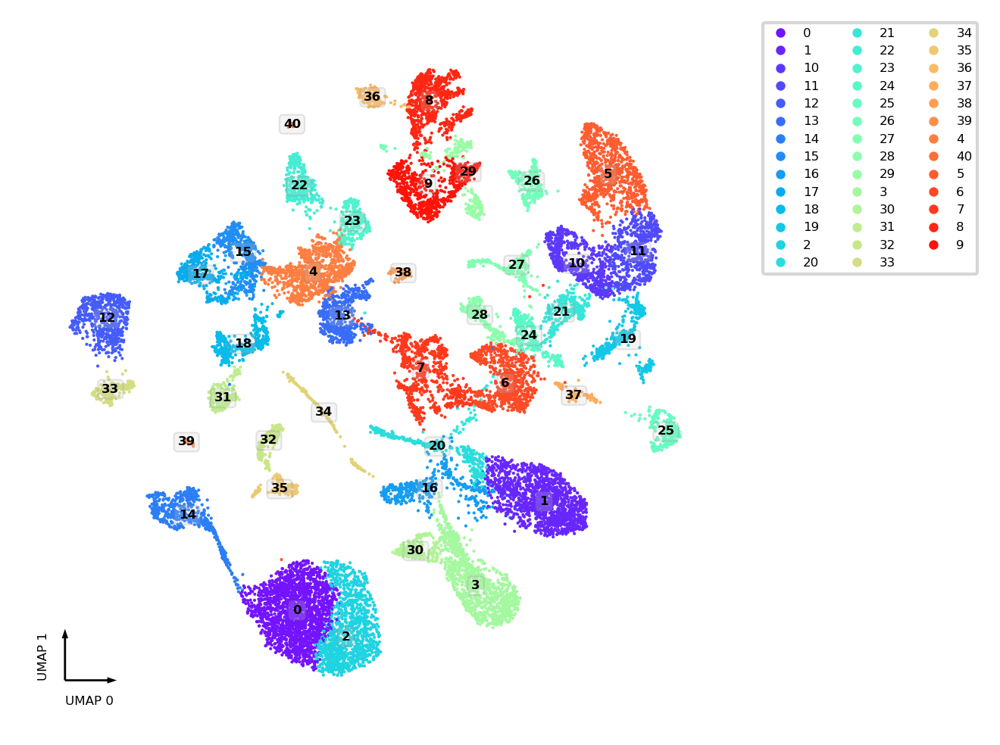

In [74]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=300)
_ = categorical_scatter(data=adata_merged,
                        ax=ax,
                        coord_base='umap',
                        hue='leiden',
                        text_anno='leiden',
                        show_legend=True)


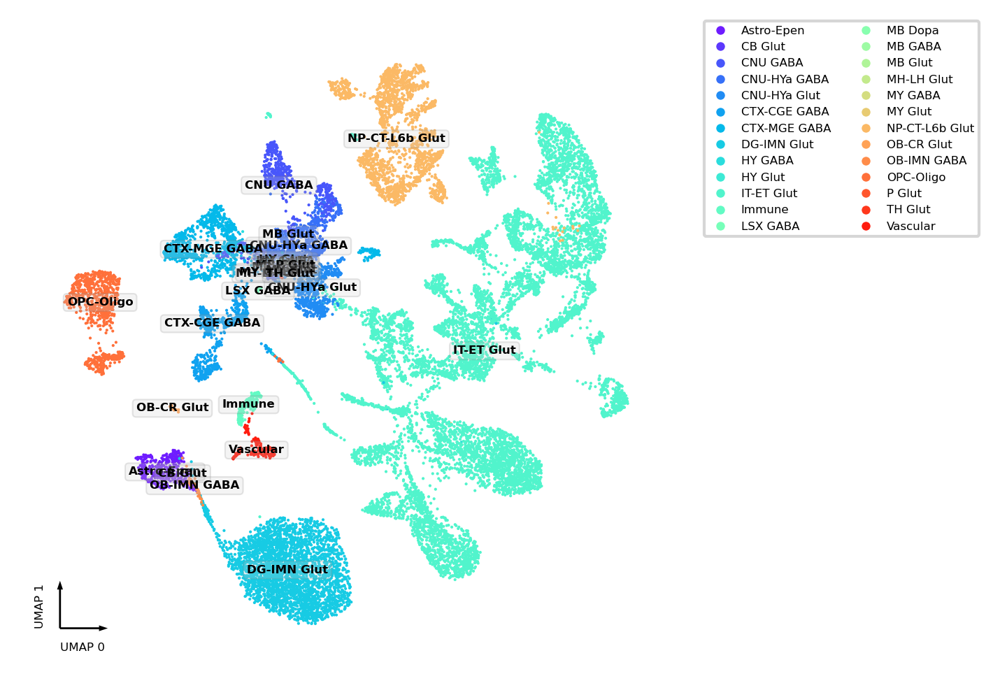

In [75]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=300)
_ = categorical_scatter(data=adata_merged,
                        ax=ax,
                        coord_base='umap',
                        hue='Class',
                        text_anno='Class',
                        show_legend=True)


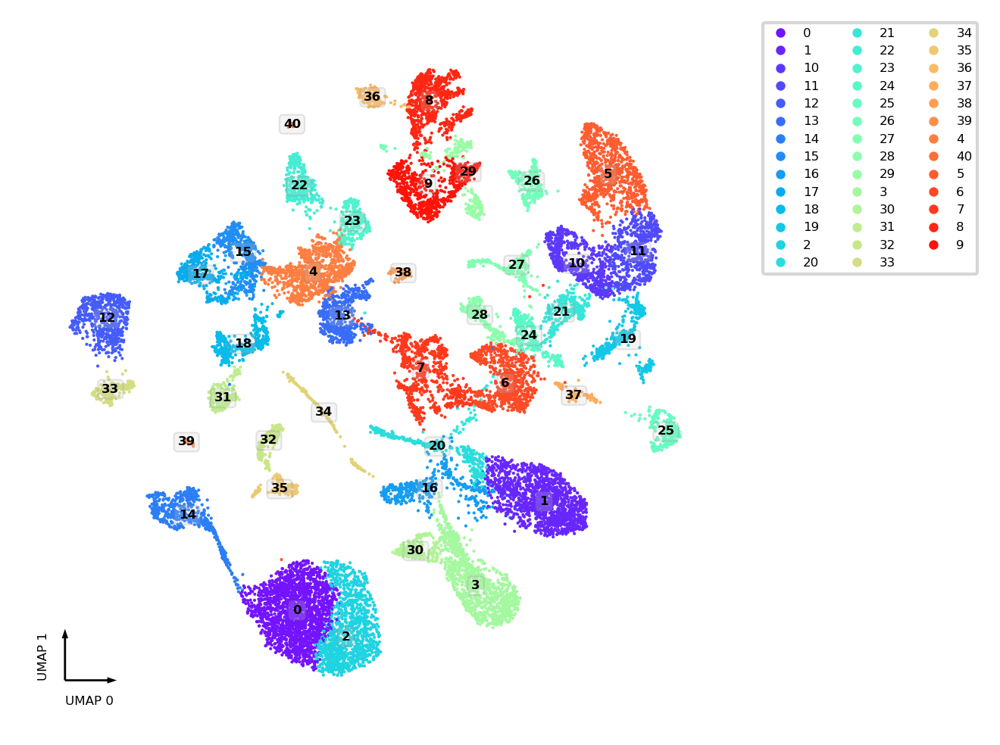

In [76]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=300)
_ = categorical_scatter(data=adata_merged,
                        ax=ax,
                        coord_base='umap',
                        hue='leiden',
                        text_anno='leiden',
                        show_legend=True)

In [77]:
pd.DataFrame(set(adata_merged.obs['SubClass'])).to_csv('output/subclass.csv.gz')

In [78]:
interactive_scatter(data=mcg,
                    hue='Class',
                    coord_base='umap',
                    max_points=3000)

In [79]:
interactive_scatter(data=adata_merged,
                    hue='Class',
                    coord_base='umap',
                    max_points=3000)

In [80]:
adata_sc.obs.columns

Index(['sample', 'group', 'n_genes_by_counts', 'log1p_n_genes_by_counts',
       'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes',
       'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes',
       'pct_counts_in_top_500_genes', 'doublet_score', 'predicted_doublet',
       'batch', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'pred_dmb',
       'pred_mwb', 'pred_mdg', 'pred_mih', 'pred_mpd', 'sampleID', 'tech',
       'louvain'],
      dtype='object')

In [81]:
map_subclass_class = dict(zip(adata_merged.obs['SubClass'], adata_merged.obs['Class']))

In [82]:
cell_class = adata_sc.obs['pred_mwb'].str.replace(r'^\d+\s', '')
convert_class = []
for i in range(0,len(cell_class)):
    cc = cell_class[i] 
    if cc not in map_subclass_class:
        convert_class.append(cc)
    else:
        convert_class.append(map_subclass_class[cc])   


/tmp/ipykernel_3560735/669084307.py:1: FutureWarning:

The default value of regex will change from True to False in a future version.



In [83]:
adata_sc.obs['pred_Class'] = convert_class

In [84]:
interactive_scatter(data=adata_sc,
                    hue='pred_mwb',
                    coord_base='umap',
                    max_points=3000)

In [85]:
interactive_scatter(data=adata_sc,
                    hue='pred_Class',
                    coord_base='umap',
                    max_points=3000)

In [86]:
interactive_scatter(data=adata_merged,
                    hue='leiden',
                    coord_base='umap',
                    max_points=5000)

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



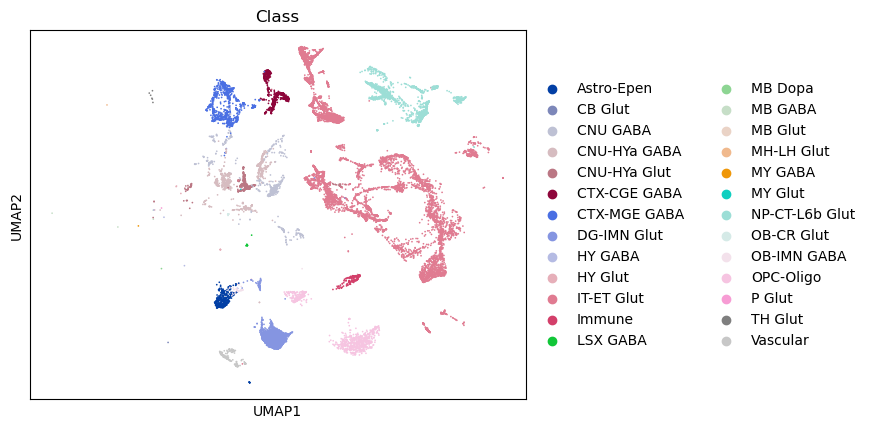

In [87]:
sc.pl.umap(mcg, color=['Class'], ncols=2)

In [88]:
adata_merged.write_h5ad('output/Brain.chrom100k-clustering.h5ad')
adata_merged


AnnData object with n_obs × n_vars = 20000 × 20000
    obs: 'mCCCFrac', 'mCGFrac', 'mCHFrac', 'FinalmCReads', 'DissectionRegion', 'Plate', 'Col384', 'Row384', 'Slice', 'Sample', 'Technology', 'InputReads', 'PassBasicQC', 'PlateNormCov', 'CEMBARegion', 'MajorRegion', 'SubRegion', 'CellGroup', 'SubClass', 'Class', 'NeuroTransmitters', 'mc_all_tsne_0', 'mc_all_tsne_1', 'mc_all_umap_0', 'mc_all_umap_1', 'mr_tsne_0', 'mr_tsne_1', 'mr_tsne_0.1', 'mr_tsne_1.1', 'leiden'
    var: 'chrom', 'cov_mean', 'end', 'start', 'CGN_mean', 'CGN_dispersion', 'CGN_cov', 'CGN_score', 'CGN_feature_select', 'CHN_mean', 'CHN_dispersion', 'CHN_cov', 'CHN_score', 'CHN_feature_select'
    uns: 'pca', 'neighbors', 'leiden', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [89]:
adata_merged.obs.to_csv('output/Brain.ClusteringResults.csv.gz')
adata_merged.obs.head()


,mCCCFrac,mCGFrac,mCHFrac,FinalmCReads,DissectionRegion,Plate,Col384,Row384,Slice,Sample,...,NeuroTransmitters,mc_all_tsne_0,mc_all_tsne_1,mc_all_umap_0,mc_all_umap_1,mr_tsne_0,mr_tsne_1,mr_tsne_0.1,mr_tsne_1.1,leiden
cell,,,,,,,,,,,,,,,,,,,,,
10D_M_64,0.006438,0.765780,0.022757,1491961.0,RHP-1,CEMBA201203_10D_5,14,0,10,10D_201203,...,Glut,55.077990,-17.641394,18.129213,1.519717,13.998060,-16.327232,13.998060,-16.327232,19
10D_M_98,0.007231,0.761465,0.025830,1004956.0,RHP-1,CEMBA201203_10D_5,2,8,10,10D_201203,...,Glut,55.956280,-16.668024,17.722948,2.063337,14.014369,-17.151241,14.014369,-17.151241,19
10D_M_111,0.006220,0.763170,0.022399,1118411.0,RHP-1,CEMBA201203_10D_5,15,12,10,10D_201203,...,Glut,55.376200,-17.724155,18.237843,1.559935,14.028082,-16.332813,14.028082,-16.332813,19
10D_M_263,0.007939,0.762790,0.025978,1538405.0,RHP-1,CEMBA201203_10D_5,20,2,10,10D_201203,...,Glut,54.280155,-16.852920,17.527954,1.093661,12.971472,-16.250986,12.971472,-16.250986,19
10D_M_265,0.006589,0.755702,0.021547,1164056.0,RHP-1,CEMBA201203_10D_5,8,2,10,10D_201203,...,Glut,55.164460,-17.910550,18.236850,1.520383,14.134044,-16.185085,14.134044,-16.185085,19


In [90]:
mcds

<xarray.MCDS>
Dimensions:                   (cell: 20000, geneslop2k-vm23: 32208, mc_type: 2)
Coordinates:
  * cell                      (cell) <U15 '10D_M_64' '10D_M_98' ... '11E_M_610'
  * geneslop2k-vm23           (geneslop2k-vm23) <U18 'ENSMUSG00000051951' ......
    geneslop2k-vm23_chrom     (geneslop2k-vm23) <U5 'chr1' 'chr1' ... 'chrM'
    geneslop2k-vm23_cov_mean  (geneslop2k-vm23) float64 6.313e+03 ... 312.2
    geneslop2k-vm23_end       (geneslop2k-vm23) int64 3673498 3515553 ... 16299
    geneslop2k-vm23_start     (geneslop2k-vm23) int64 3203901 3464587 ... 12145
  * mc_type                   (mc_type) <U3 'CGN' 'CHN'
Data variables:
    geneslop2k-vm23_da_frac   (cell, geneslop2k-vm23, mc_type) float32 dask.array<chunksize=(1000, 32208, 1), meta=np.ndarray>
Attributes:
    obs_dim:  cell
    var_dim:  geneslop2k-vm23

In [91]:
n_genes =10000

In [92]:
sc.pp.highly_variable_genes(mcg, n_top_genes=n_genes, n_bins=20)

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:218: RuntimeWarning:

invalid value encountered in log



In [93]:
sc.pp.highly_variable_genes(mch, n_top_genes=n_genes, n_bins=20)

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:218: RuntimeWarning:

invalid value encountered in log



In [94]:
adata_raw = sc.read_10x_mtx("/data1st1/seq_from_our_lab/NovaSeq_mmBrain_X101SC24104268-Z01/X101SC24104268-Z01-J001/seeksoul_output/W1/step3/filtered_feature_bc_matrix")

In [95]:
adata_raw.var

,gene_ids,feature_types
Xkr4,ENSMUSG00000051951,Gene Expression
Gm37381,ENSMUSG00000102343,Gene Expression
Rp1,ENSMUSG00000025900,Gene Expression
Sox17,ENSMUSG00000025902,Gene Expression
Gm37323,ENSMUSG00000104328,Gene Expression
...,...,...
AC168977.1,ENSMUSG00000079808,Gene Expression
AC149090.1,ENSMUSG00000095041,Gene Expression
CAAA01118383.1,ENSMUSG00000063897,Gene Expression
Vmn2r122,ENSMUSG00000096730,Gene Expression


In [96]:
adata_sc.var['gane_name'] = adata_sc.var.index

In [97]:
adata_sc.var

,mt,n_cells_by_counts-0,mean_counts-0,log1p_mean_counts-0,pct_dropout_by_counts-0,total_counts-0,log1p_total_counts-0,highly_variable-0,means-0,dispersions-0,...,variances-1,variances_norm-1,highly_variable_nbatches-1,highly_variable,highly_variable_rank,means,variances,variances_norm,highly_variable_nbatches,gane_name
Xkr4,False,40547,15.705115,2.815715,13.004205,731984.0,13.503515,False,15.705115,1.828880,...,24.259528,1.052374,0,False,NaN,11.067082,246.025292,1.100350,0,Xkr4
Gm37381,False,99,0.002188,0.002186,99.787590,102.0,4.634729,False,0.002188,0.885140,...,0.000092,0.995483,0,False,NaN,0.001325,0.001399,0.963477,0,Gm37381
Rp1,False,1384,0.031754,0.031260,97.030553,1480.0,7.300473,False,0.031754,0.584985,...,0.002478,0.992670,0,False,NaN,0.019655,0.022097,0.918056,0,Rp1
Sox17,False,98,0.003733,0.003726,99.789736,174.0,5.164786,True,0.003733,2.791106,...,0.000613,1.133911,1,True,861.0,0.002398,0.007038,1.847386,5,Sox17
Gm37323,False,13,0.000279,0.000279,99.972108,13.0,2.639057,False,0.000279,-0.820078,...,0.000031,0.500068,0,False,NaN,0.000177,0.000177,0.651889,0,Gm37323
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC168977.1,False,36,0.000772,0.000772,99.922760,36.0,3.610918,False,0.000772,1.998929,...,0.000031,0.500068,0,False,NaN,0.000467,0.000467,0.790622,0,AC168977.1
AC149090.1,False,33180,4.590049,1.720988,28.810505,213933.0,12.273423,False,4.590049,1.670890,...,1.900554,1.052991,0,False,1812.0,3.094765,26.906226,1.122198,2,AC149090.1
CAAA01118383.1,False,3490,0.083248,0.079963,92.512015,3880.0,8.263848,False,0.083248,1.323510,...,0.016454,0.953380,0,False,NaN,0.055607,0.064281,0.895764,0,CAAA01118383.1
Vmn2r122,False,0,0.000000,0.000000,100.000000,0.0,0.000000,False,0.000000,NaN,...,0.000000,0.000000,0,False,NaN,0.000000,0.000000,0.000000,0,Vmn2r122


In [98]:
var_merged = adata_raw.var.merge(adata_sc.var,how='outer',left_index=True,right_index=True,indicator=True)
var_merged

,gene_ids,feature_types,mt,n_cells_by_counts-0,mean_counts-0,log1p_mean_counts-0,pct_dropout_by_counts-0,total_counts-0,log1p_total_counts-0,highly_variable-0,...,variances_norm-1,highly_variable_nbatches-1,highly_variable,highly_variable_rank,means,variances,variances_norm,highly_variable_nbatches,gane_name,_merge
0610006L08Rik,ENSMUSG00000108652,Gene Expression,False,488.0,0.010771,0.010713,98.952969,502.0,6.220590,False,...,1.199852,2.0,False,1289.5,0.006552,0.006938,0.981850,2.0,0610006L08Rik,both
0610009B22Rik,ENSMUSG00000007777,Gene Expression,False,3681.0,0.086165,0.082654,92.102214,4016.0,8.298290,False,...,0.951403,0.0,False,NaN,0.055316,0.061725,0.870921,0.0,0610009B22Rik,both
0610010F05Rik,ENSMUSG00000042208,Gene Expression,False,29100.0,1.691684,0.990167,37.564367,78846.0,11.275265,False,...,0.936489,0.0,False,NaN,1.169863,3.464708,0.941099,0.0,0610010F05Rik,both
0610010K14Rik,ENSMUSG00000020831,Gene Expression,False,2797.0,0.065182,0.063146,93.998884,3038.0,8.019284,False,...,0.963431,0.0,False,NaN,0.041632,0.046843,0.880443,0.0,0610010K14Rik,both
0610012G03Rik,ENSMUSG00000107002,Gene Expression,False,9999.0,0.278944,0.246034,78.546601,13001.0,9.472858,False,...,0.993750,0.0,False,NaN,0.188735,0.264457,0.948035,0.0,0610012G03Rik,both
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
mt-Nd3,ENSMUSG00000064360,Gene Expression,True,1271.0,0.033771,0.033213,97.273000,1574.0,7.362010,True,...,0.999874,0.0,True,1005.0,0.025651,0.045999,1.134224,1.0,mt-Nd3,both
mt-Nd4,ENSMUSG00000064363,Gene Expression,True,8277.0,0.706810,0.534626,82.241246,32943.0,10.402564,True,...,1.138509,1.0,True,62.0,0.468612,40.777472,8.289056,5.0,mt-Nd4,both
mt-Nd4l,ENSMUSG00000065947,Gene Expression,True,1777.0,0.069323,0.067026,96.187350,3231.0,8.080856,True,...,1.030246,0.0,True,897.0,0.043008,0.317972,2.459168,3.0,mt-Nd4l,both
mt-Nd5,ENSMUSG00000064367,Gene Expression,True,3155.0,0.224961,0.202909,93.230776,10485.0,9.257796,True,...,1.045469,0.0,True,314.0,0.143454,5.049482,5.491102,4.0,mt-Nd5,both


In [99]:
adata_sc.var.index

Index(['Xkr4', 'Gm37381', 'Rp1', 'Sox17', 'Gm37323', 'Mrpl15', 'Lypla1',
       'Tcea1', 'Rgs20', 'Atp6v1h',
       ...
       'AC125149.1', 'AC125149.2', 'AC125149.4', 'AC234645.1', 'AC168977.2',
       'AC168977.1', 'AC149090.1', 'CAAA01118383.1', 'Vmn2r122',
       'CAAA01147332.1'],
      dtype='object', length=27734)

In [100]:
adata_sc.var = var_merged.loc[adata_sc.var.index]

In [101]:
adata_sc.var.set_index('gene_ids',inplace=True)

In [102]:
adata_atac_gene = adata.read_h5ad('/data2st1/junyi/snATAC_02_matrix/WT_PFC_W26_geneactivity_n.h5ad')
adata_atac_bin = adata.read_h5ad('/data2st1/junyi/snATAC_02_matrix/WT_PFC_W26_5kb.h5ad')

In [103]:
pcs = pd.read_csv('/data2st1/junyi/snATAC_02_matrix/combined_atac_QC_reduction_pcs.csv',index_col=0)

In [104]:
pcs.index

Index(['CUMS_AAACGAAAGACACGGT-1', 'CUMS_AAACGAAAGAGGTACC-1',
       'CUMS_AAACGAAAGCGTCAAG-1', 'CUMS_AAACGAAAGGCAAGCT-1',
       'CUMS_AAACGAAAGGCTCAGA-1', 'CUMS_AAACGAAAGTAACTCC-1',
       'CUMS_AAACGAAAGTACTCTG-1', 'CUMS_AAACGAAAGTAGACCG-1',
       'CUMS_AAACGAAAGTGAGTTA-1', 'CUMS_AAACGAAAGTGTCACT-1',
       ...
       'WT_TTTGTGTGTGTTTCTT-1', 'WT_TTTGTGTGTTAGCTCA-1',
       'WT_TTTGTGTGTTGCAGCC-1', 'WT_TTTGTGTGTTTCGATG-1',
       'WT_TTTGTGTGTTTGATCG-1', 'WT_TTTGTGTTCACGTCAA-1',
       'WT_TTTGTGTTCCAACAAC-1', 'WT_TTTGTGTTCCGTACGG-1',
       'WT_TTTGTGTTCCTGACCT-1', 'WT_TTTGTGTTCTGACTTT-1'],
      dtype='object', length=31817)

In [105]:
len(set("WT_"+adata_atac_bin.obs.index).intersection(set(pcs.index)))

12971

In [106]:
adata_atac_bin.obs.index = "WT_"+adata_atac_bin.obs.index

In [107]:
adata_atac_gene.obs.index = "WT_"+adata_atac_gene.obs.index

In [108]:
adata_atac_gene

AnnData object with n_obs × n_vars = 13000 × 21439
    obs: 'orig.ident', 'nCount_peaks', 'nFeature_peaks', 'total', 'duplicate', 'chimeric', 'unmapped', 'lowmapq', 'mitochondrial', 'nonprimary', 'passed_filters', 'is__cell_barcode', 'excluded_reason', 'TSS_fragments', 'DNase_sensitive_region_fragments', 'enhancer_region_fragments', 'promoter_region_fragments', 'on_target_fragments', 'blacklist_region_fragments', 'peak_region_fragments', 'peak_region_cutsites', 'nCount_ACTIVITY', 'nFeature_ACTIVITY'

In [109]:
merge_barcode = adata_atac_gene.obs.merge(pcs,left_index=True,right_index=True,how='inner')

In [110]:
adata_atac_selected = adata_atac_gene[merge_barcode.index]

In [111]:
adata_atac_selected.obsm['X_pca'] = pcs.loc[merge_barcode.index].iloc[:,1:].values
# Ignore the first pc 

In [112]:
adata_atac_selected.obsm['X_pca'].shape

(12971, 49)

In [113]:
adata_atac_selected

AnnData object with n_obs × n_vars = 12971 × 21439
    obs: 'orig.ident', 'nCount_peaks', 'nFeature_peaks', 'total', 'duplicate', 'chimeric', 'unmapped', 'lowmapq', 'mitochondrial', 'nonprimary', 'passed_filters', 'is__cell_barcode', 'excluded_reason', 'TSS_fragments', 'DNase_sensitive_region_fragments', 'enhancer_region_fragments', 'promoter_region_fragments', 'on_target_fragments', 'blacklist_region_fragments', 'peak_region_fragments', 'peak_region_cutsites', 'nCount_ACTIVITY', 'nFeature_ACTIVITY'
    obsm: 'X_pca'

In [114]:
adata_atac_selected.obs.head()

,orig.ident,nCount_peaks,nFeature_peaks,total,duplicate,chimeric,unmapped,lowmapq,mitochondrial,nonprimary,...,TSS_fragments,DNase_sensitive_region_fragments,enhancer_region_fragments,promoter_region_fragments,on_target_fragments,blacklist_region_fragments,peak_region_fragments,peak_region_cutsites,nCount_ACTIVITY,nFeature_ACTIVITY
WT_AAACGAAAGACACGGT-1,SeuratProject,14480.0,6996,38701,6793,6,86,2071,60,16,...,5578,0,0,0,5578,0,7712,14480,17721.0,7257
WT_AAACGAAAGAGGTACC-1,SeuratProject,16886.0,7551,23069,7779,9,46,644,0,7,...,4250,0,0,0,4250,0,8722,16886,9815.0,5263
WT_AAACGAAAGCGTCAAG-1,SeuratProject,24249.0,11145,44104,7599,22,105,2102,31,31,...,8187,0,0,0,8187,0,12735,24249,20537.0,8334
WT_AAACGAAAGGCAAGCT-1,SeuratProject,22916.0,10513,42602,6830,13,104,2052,24,23,...,7960,0,0,0,7960,0,11994,22916,20641.0,9027
WT_AAACGAAAGTAACTCC-1,SeuratProject,19048.0,8490,25154,7035,9,74,857,19,32,...,4831,0,0,0,4831,0,9842,19048,11462.0,5752


In [115]:
df_atac_umapdf_atac_umap = pd.read_csv('/data2st1/junyi/snATAC_02_matrix/combined_atac_QC_reduction_umap.csv',index_col=0)
adata_atac_selected.obsm['X_umap_seurat'] = df_atac_umapdf_atac_umap.loc[merge_barcode.index].values

In [116]:
def dump_embedding(adata, name, n_dim=2):
    # put manifold coordinates into adata.obs
    for i in range(n_dim):
        adata.obs[f'{name}_{i}'] = adata.obsm[f'X_{name}'][:, i]
    return


In [117]:
sc.pp.neighbors(adata_atac_selected)
sc.tl.leiden(adata_atac_selected, resolution=1)
sc.tl.umap(adata_atac_selected)
dump_embedding(adata_atac_selected, 'umap')


In [118]:
dump_embedding(adata_atac_selected, 'umap')
dump_embedding(adata_atac_selected, 'umap_seurat')


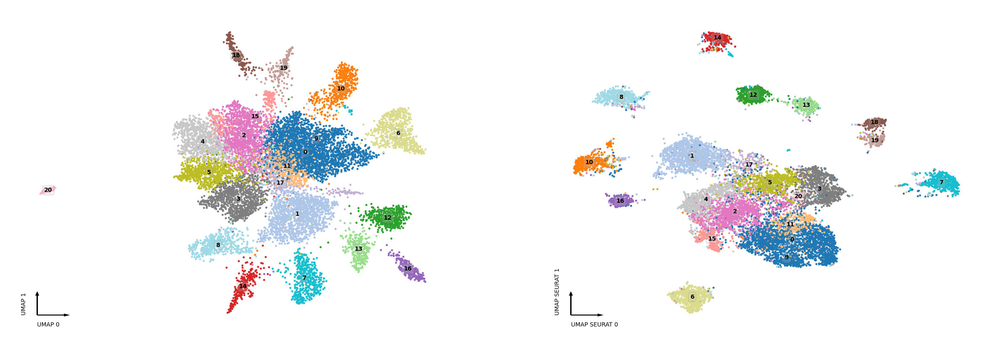

In [119]:
fig, axes = plt.subplots(figsize=(12, 4), dpi=250, ncols=2)

ax = axes[0]
_ = categorical_scatter(data=adata_atac_selected.obs,
                        ax=ax,
                        coord_base='umap',
                        hue='leiden',
                        palette='tab20',
                        text_anno='leiden')
ax = axes[1]
_ = categorical_scatter(data=adata_atac_selected.obs,
                        ax=ax,
                        coord_base='umap_seurat',
                        hue='leiden',
                        palette='tab20',
                        text_anno='leiden')



In [120]:
n_components = significant_pc_test(adata_atac_selected)


24 components passed P cutoff of 0.1.
Changing adata.obsm['X_pca'] from shape (12971, 49) to (12971, 24)


/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/plot/decomposition.py:46: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/plot/decomposition.py:46: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/plot/decomposition.py:46: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/plot/decomposition.py:46: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/plot/decomposition.py:46: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/plot/decompos

Red axis labels are used PCs


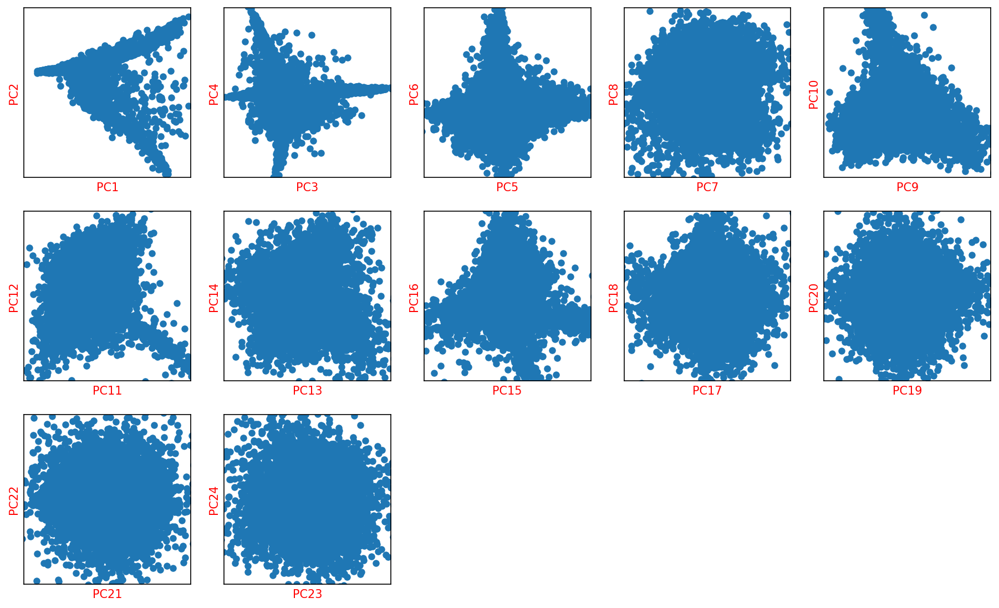

In [121]:
fig, axes = plot_decomp_scatters(adata_atac_selected,
                                 n_components=n_components,
                                 hue=None,
                                 hue_quantile=(0.25, 0.75),
                                 nrows=5,
                                 ncols=5)

In [177]:
n_genes = 5000
sc.pp.highly_variable_genes(adata_atac_selected, n_top_genes=n_genes, n_bins=20) 

In [178]:
adata_atac_selected.var['gene_id'] = adata_atac_selected.var.index.str.split('.').str[0]

In [179]:
adata_atac_selected.var.set_index('gene_id',inplace=True)

In [180]:
sc_hvf_list = adata_sc.var['variances_norm'].sort_values(ascending=False).dropna()[:n_genes].index


In [181]:
mcg_hvf_list = mcg.var['dispersions_norm'].sort_values(ascending=False).dropna()[:n_genes].index

mch_hvf_list = mch.var['dispersions_norm'].sort_values(ascending=False).dropna()[:n_genes].index
atac_hvf_list = adata_atac_selected.var['dispersions_norm'].sort_values(ascending=False).dropna()[:n_genes].index


In [182]:
hvfs = sc_hvf_list.intersection(atac_hvf_list)

In [183]:
len(hvfs)

1146

In [136]:
df_annoatation = pd.read_csv('output/df_PFC_annotation.csv',index_col=0)

In [152]:
df_celltype = df_annoatation[['celltype.L1',
       'Neurotransmitter', 'Neurotransmitter_celltype', 'celltype.L2','rowname']]

In [153]:
df_celltype.set_index('rowname',inplace=True)

In [154]:
df_celltype

,celltype.L1,Neurotransmitter,Neurotransmitter_celltype,celltype.L2
rowname,,,,
AAACCCAAGCTAGCCC-1-0-0-1,Neuron,NaN,GABAergic,Pvalb GABA
AAACCCAAGCTGGAGT-1-0-0-1,Neuron,NaN,Glutamatergic,L2/3 IT
AAACCCAAGGATACCG-1-0-0-1,Neuron,NaN,Glutamatergic,L6 IT
AAACCCAAGGGTCACA-1-0-0-1,Neuron,NaN,Glutamatergic,L6 CT
AAACCCAAGTGCTAGG-1-0-0-1,Neuron,NaN,Glutamatergic,L4/5 IT
...,...,...,...,...
TTTGTTGTCATTCTTG-1-0-0-1,Astro-Epen,NaN,NaN,Astrocyte-Gfaplow
TTTGTTGTCCTCACCA-1-0-0-1,Neuron,NaN,GABAergic,Sst GABA
TTTGTTGTCGCCAATA-1-0-0-1,Neuron,NaN,Glutamatergic,L2/3 IT


In [155]:
adata_sc.obs = adata_sc.obs.merge(df_celltype,left_index=True,right_index=True,how='left')

In [146]:
adata_sc_selected = adata_sc[(adata_sc.obs.tech == '10x') & (adata_sc.obs.group == 'W')]

In [157]:
adata_sc_selected.obs = adata_sc_selected.obs.merge(df_celltype,left_index=True,right_index=True,how='left')

In [158]:
adata_sc_selected

AnnData object with n_obs × n_vars = 17955 × 27734
    obs: 'sample', 'group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'doublet_score', 'predicted_doublet', 'batch', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'pred_dmb', 'pred_mwb', 'pred_mdg', 'pred_mih', 'pred_mpd', 'sampleID', 'tech', 'louvain', 'pred_Class', 'celltype.L1', 'Neurotransmitter', 'Neurotransmitter_celltype', 'celltype.L2'
    var: 'feature_types', 'mt', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable_rank-0', 'variances-0', 'variances_norm-0', 'highly_variable_nbatches-0', 'n_cells_by_counts-1', 'mean_counts-1', 'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'l

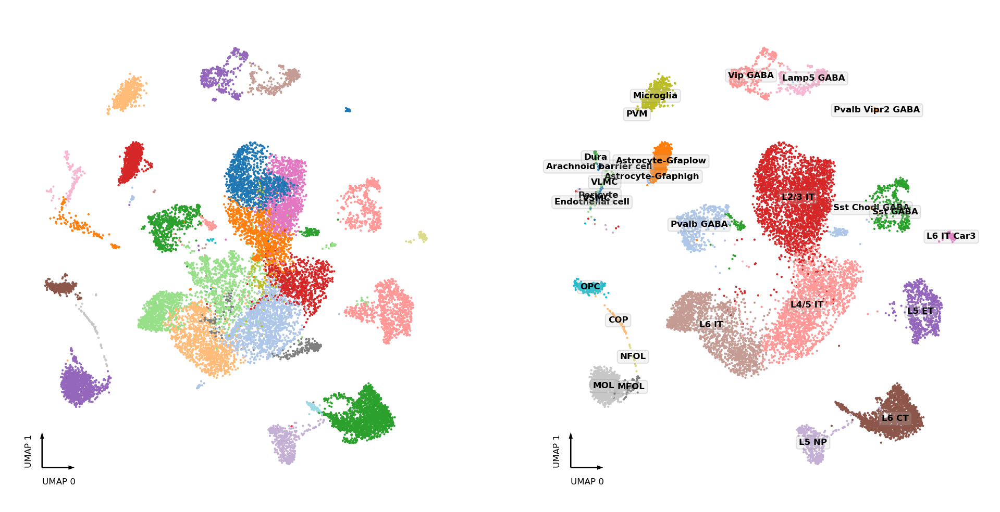

In [167]:
fig, axes = plt.subplots(figsize=(8, 4), dpi=300, ncols=2)
ax = axes[0]
categorical_scatter(ax=ax, data=adata_sc_selected, hue='louvain', palette='tab20')
ax = axes[1]
categorical_scatter(ax=ax, data=adata_sc_selected, hue='celltype.L2', palette='tab20',text_anno='celltype.L2')

In [184]:
sc_hvf_adata = adata_sc_selected[:,hvfs].copy()
sc_hvf_adata=sc_hvf_adata[sc_hvf_adata.obs.group=="W"]
sc.pp.scale(sc_hvf_adata)
sc_hvf_adata

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning:

Received a view of an AnnData. Making a copy.



AnnData object with n_obs × n_vars = 17955 × 1146
    obs: 'sample', 'group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'doublet_score', 'predicted_doublet', 'batch', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'pred_dmb', 'pred_mwb', 'pred_mdg', 'pred_mih', 'pred_mpd', 'sampleID', 'tech', 'louvain', 'pred_Class', 'celltype.L1', 'Neurotransmitter', 'Neurotransmitter_celltype', 'celltype.L2'
    var: 'feature_types', 'mt', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable_rank-0', 'variances-0', 'variances_norm-0', 'highly_variable_nbatches-0', 'n_cells_by_counts-1', 'mean_counts-1', 'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'lo

In [185]:
mcg.var.index = mcg.var.index.astype(str)
mcg.obs.index = mcg.obs.index.astype(str)
mch.var.index = mch.var.index.astype(str)
mch.obs.index = mch.obs.index.astype(str)

In [187]:
# mcg_hvf_adata = mcg[:,hvfs].copy()
# sc.pp.scale(mcg_hvf_adata)
# mcg_hvf_adata.X *=-1
# mch_hvf_adata = mch[:,hvfs].copy()
# sc.pp.scale(mch_hvf_adata)
# mch_hvf_adata.X *=-1

In [188]:
atac_hvf_adata = adata_atac_selected[:,hvfs].copy()
sc.pp.scale(atac_hvf_adata)

In [204]:
adata_concat = sc_hvf_adata.concatenate([
    # mcg_hvf_adata,
    # mch_hvf_adata,
    atac_hvf_adata
    
],
                                index_unique='-')
adata_concat.obs['batch'] = adata_concat.obs['batch'].map({
    '0': 'sc',
    # '1': 'mcg',
    # '2': 'mch',
    '1': 'atac'
    })
adata_concat

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning:

The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html



AnnData object with n_obs × n_vars = 30926 × 1146
    obs: 'sample', 'group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'doublet_score', 'predicted_doublet', 'batch', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'pred_dmb', 'pred_mwb', 'pred_mdg', 'pred_mih', 'pred_mpd', 'sampleID', 'tech', 'louvain', 'pred_Class', 'celltype.L1', 'Neurotransmitter', 'Neurotransmitter_celltype', 'celltype.L2', 'orig.ident', 'nCount_peaks', 'nFeature_peaks', 'total', 'duplicate', 'chimeric', 'unmapped', 'lowmapq', 'mitochondrial', 'nonprimary', 'passed_filters', 'is__cell_barcode', 'excluded_reason', 'TSS_fragments', 'DNase_sensitive_region_fragments', 'enhancer_region_fragments', 'promoter_region_fragments', 'on_target_fragments', 'blacklist_region_fragments', 'peak_region_fragments', 'peak_region_cutsites', 'nCount_ACTIVITY', 'nFeature_A

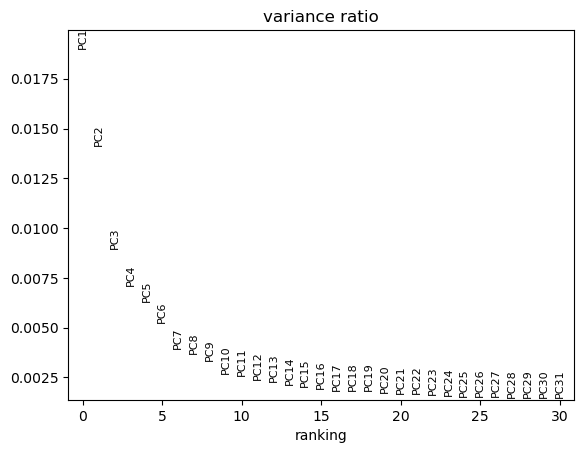

23 components passed P cutoff of 0.2.
Changing adata.obsm['X_pca'] from shape (30926, 50) to (30926, 23)


In [205]:
sc.pp.pca(adata_concat, n_comps=50)
sc.pl.pca_variance_ratio(adata_concat)
n_components = significant_pc_test(adata_concat, p_cutoff=0.2)


In [206]:
adata_atac_selected

AnnData object with n_obs × n_vars = 12971 × 21439
    obs: 'orig.ident', 'nCount_peaks', 'nFeature_peaks', 'total', 'duplicate', 'chimeric', 'unmapped', 'lowmapq', 'mitochondrial', 'nonprimary', 'passed_filters', 'is__cell_barcode', 'excluded_reason', 'TSS_fragments', 'DNase_sensitive_region_fragments', 'enhancer_region_fragments', 'promoter_region_fragments', 'on_target_fragments', 'blacklist_region_fragments', 'peak_region_fragments', 'peak_region_cutsites', 'nCount_ACTIVITY', 'nFeature_ACTIVITY', 'leiden', 'umap_0', 'umap_1', 'umap_seurat_0', 'umap_seurat_1'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'neighbors', 'leiden', 'umap', 'hvg'
    obsm: 'X_pca', 'X_umap_seurat', 'X_umap'
    obsp: 'distances', 'connectivities'

In [208]:
adata_concat.obs['predicted_doublet'].fillna('False',inplace=True)
adata_concat.obs["predicted_doublet"] = adata_concat.obs["predicted_doublet"].astype(bool)

adata_concat.var['mt-0'] = adata_concat.var["mt-0"].astype(bool)
adata_concat.var['highly_variable-0-0'] = adata_concat.var["highly_variable-0-0"].astype(bool)
adata_concat.var['highly_variable-1-0'] = adata_concat.var["highly_variable-1-0"].astype(bool)
adata_concat.var['highly_variable-0'] = adata_concat.var["highly_variable-0"].astype(bool)

#adata_concat.obs['PassBasicQC'] = adata_concat.obs["PassBasicQC"].astype(bool)


In [209]:
adata_concat.write_h5ad('output/merged-concat-snatac-clustering.h5ad')

In [210]:
ho = run_harmony(adata_concat.obsm['X_pca'],
                 meta_data=pd.DataFrame(adata_concat.obs['batch']),
                 vars_use='batch',
                 random_state=0,
                 nclust=100,
                 max_iter_harmony=20)
#adata_concat.obsm['X_pca'] = ho.Z_corr.T


2025-01-14 17:00:12,571 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


2025-01-14 17:00:14,661 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-01-14 17:00:14,699 - harmonypy - INFO - Iteration 1 of 20
2025-01-14 17:00:17,417 - harmonypy - INFO - Iteration 2 of 20
2025-01-14 17:00:20,124 - harmonypy - INFO - Converged after 2 iterations


In [211]:
adata_concat.write_h5ad('output/merged-harmony-snatac-clustering.h5ad')

In [212]:
adata_concat.obsm['X_pca'] = ho.Z_corr.T


In [253]:
sc.pp.neighbors(adata_concat, n_neighbors=20)
sc.tl.leiden(adata_concat, resolution=1.5)
sc.tl.umap(adata_concat)


Red axis labels are used PCs


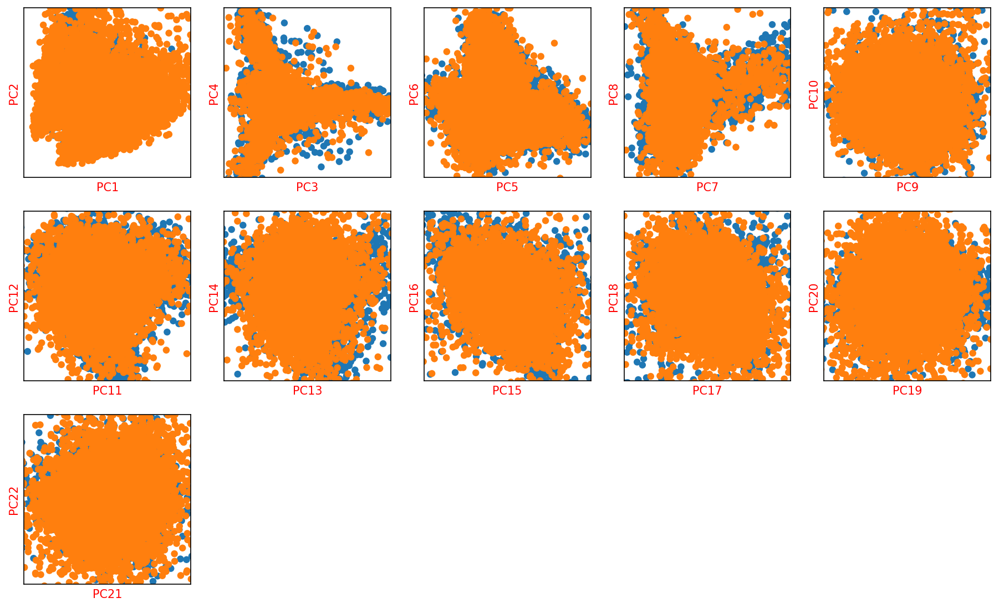

In [254]:
_ = plot_decomp_scatters(adata_concat,
                         n_components=n_components,
                         hue='batch',
                         palette='tab10')

In [255]:
adata_concat.obs['umap_0'] = adata_concat.obsm['X_umap'][:, 0]
adata_concat.obs['umap_1'] = adata_concat.obsm['X_umap'][:, 1]


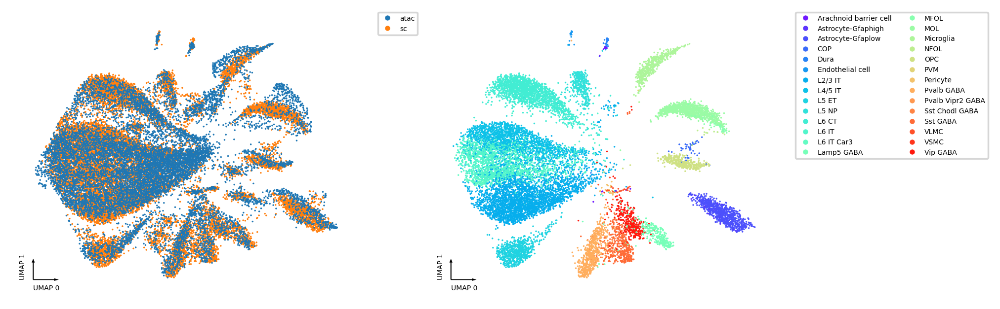

In [256]:
fig, axes = plt.subplots(figsize=(8, 3), dpi=250, ncols=2)

ax = axes[0]
categorical_scatter(ax=ax,
                    data=adata_concat,
                    hue='batch',
                    show_legend=True,
                    max_points=None,
                    s=1)

ax = axes[1]
categorical_scatter(ax=ax,
                    data=adata_concat,
                    hue='celltype.L2',
                    show_legend=True,
                    max_points=None,
                    s=1)

In [260]:
adata_sc_train = adata_concat[adata_concat.obs['batch'] == 'sc']

In [262]:
 adata_sc_train.obsm['X_pca'].shape

(17955, 23)

In [263]:
from sklearn.svm import SVC
from sklearn.preprocessing import LabelEncoder
y_train = adata_sc_train.obs['celltype.L2']
le = LabelEncoder()
y_train = le.fit_transform(y_train)
X_train = adata_sc_train.obsm['X_pca']

In [266]:
clf = SVC(kernel='linear', C=1)
clf.fit(X_train, y_train)

SVC(C=1, kernel='linear')

In [268]:
adata_sc_test = adata_concat[adata_concat.obs['batch'] == 'atac']
X_test = adata_sc_test.obsm['X_pca']
y_test = clf.predict(X_test)

In [270]:
y_test = le.inverse_transform(y_test)

In [272]:
adata_sc_test.obs['predicted_celltype'] = y_test

/tmp/ipykernel_3560735/1270472714.py:1: ImplicitModificationWarning:

Trying to modify attribute `.obs` of view, initializing view as actual.



/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



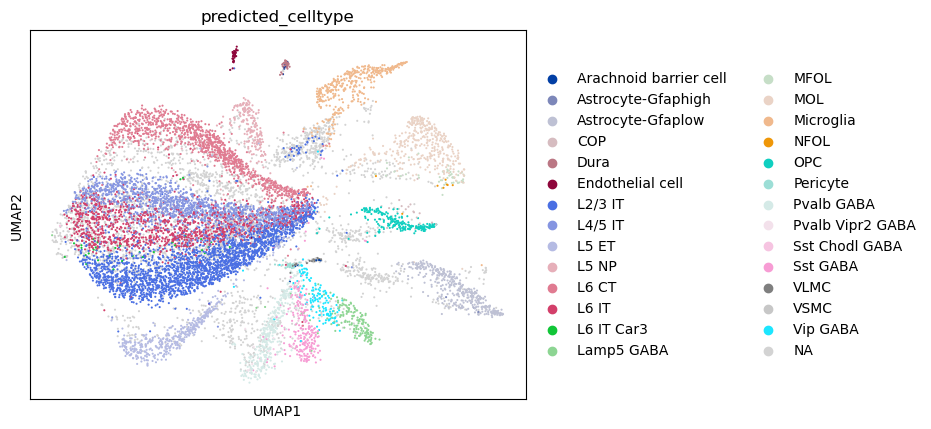

In [273]:
sc.pl.umap(adata_sc_test, color=['predicted_celltype'], ncols=2)

In [284]:
y_test

array(['L6 IT', 'L4/5 IT', nan, ..., 'L2/3 IT', nan, nan], dtype=object)

In [288]:
adata_concat.obs['celltype.L2.p'] = adata_concat.obs['celltype.L2']

In [289]:
adata_concat.obs.loc[adata_sc_test.obs.index,'celltype.L2']=y_test

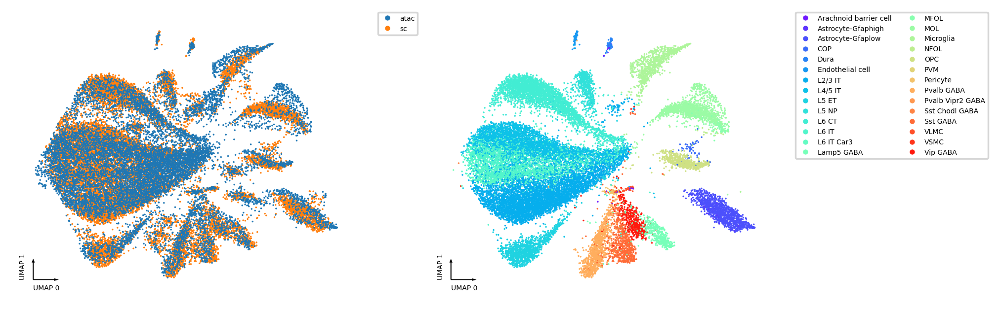

In [292]:
fig, axes = plt.subplots(figsize=(8, 3), dpi=250, ncols=2)

ax = axes[0]
categorical_scatter(ax=ax,
                    data=adata_concat,
                    hue='batch',
                    show_legend=True,
                    max_points=None,
                    s=1)

ax = axes[1]
categorical_scatter(ax=ax,
                    data=adata_concat,
                    hue='celltype.L2',
                    show_legend=True,
                    max_points=None,
                    s=1)

In [294]:
y_train = adata_sc_train.obs['celltype.L1']
le = LabelEncoder()
y_train = le.fit_transform(y_train)
clf.fit(X_train, y_train)

SVC(C=1, kernel='linear')

In [295]:
y_test = clf.predict(X_test)
y_test = le.inverse_transform(y_test)
adata_sc_test.obs['predicted_celltype'] = y_test

/home/junyichen/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



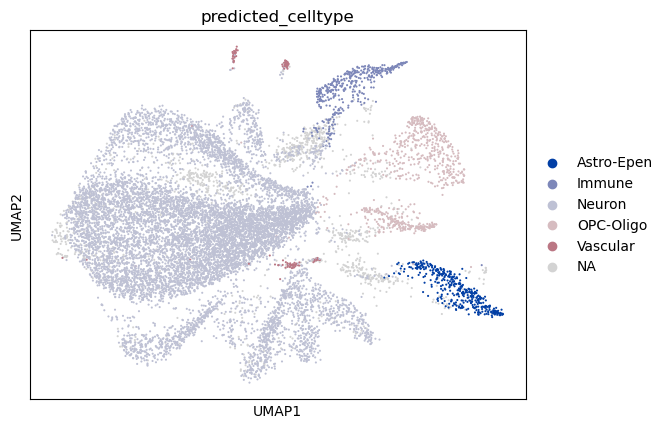

In [296]:
sc.pl.umap(adata_sc_test, color=['predicted_celltype'], ncols=2)

In [297]:
adata_concat.obs['celltype.L1.p'] = adata_concat.obs['celltype.L1']

In [298]:
adata_concat.obs.loc[adata_sc_test.obs.index,'celltype.L1']=y_test

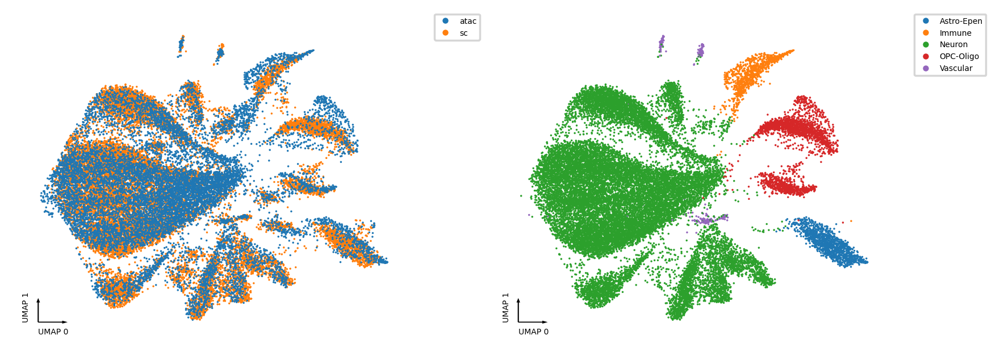

In [299]:
fig, axes = plt.subplots(figsize=(8, 3), dpi=250, ncols=2)

ax = axes[0]
categorical_scatter(ax=ax,
                    data=adata_concat,
                    hue='batch',
                    show_legend=True,
                    max_points=None,
                    s=1)

ax = axes[1]
categorical_scatter(ax=ax,
                    data=adata_concat,
                    hue='celltype.L1',
                    show_legend=True,
                    max_points=None,
                    s=1)

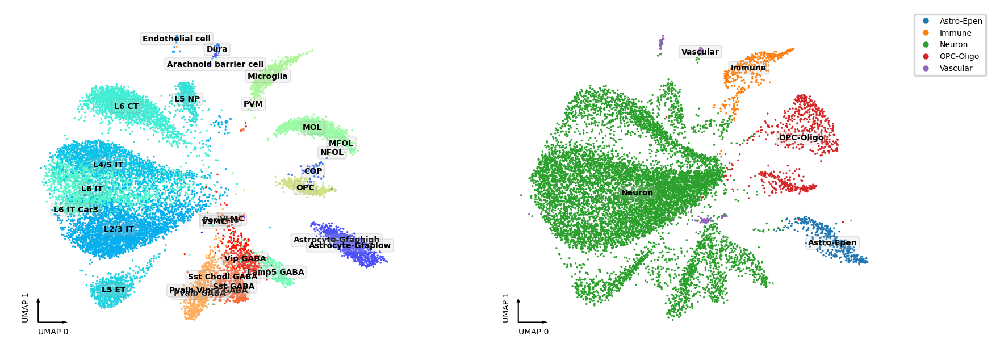

In [308]:
fig, axes = plt.subplots(figsize=(8, 3), dpi=250, ncols=2)

data = adata_concat.obs[adata_concat.obs['batch'] == 'sc'].copy()
#data['MajorType'] = data['SubType'].str.split('_').str[-1]
data2 = adata_concat.obs[adata_concat.obs['batch'] == 'atac'].copy()


ax = axes[0]
categorical_scatter(ax=ax,
                    data=data,
                    show_legend=False,
                    max_points=None,
                    hue='celltype.L2',
                    text_anno='celltype.L2',
                    s=1)

ax = axes[1]
categorical_scatter(ax=ax,
                    data=data2,
                    hue='celltype.L1',
                    show_legend=True,
                    text_anno='celltype.L1',

                    max_points=None,
                    s=1)

In [222]:
adata_sc.obs.columns

Index(['sample', 'group', 'n_genes_by_counts', 'log1p_n_genes_by_counts',
       'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes',
       'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes',
       'pct_counts_in_top_500_genes', 'doublet_score', 'predicted_doublet',
       'batch', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'pred_dmb',
       'pred_mwb', 'pred_mdg', 'pred_mih', 'pred_mpd', 'sampleID', 'tech',
       'louvain', 'pred_Class', 'celltype.L1', 'Neurotransmitter',
       'Neurotransmitter_celltype', 'celltype.L2'],
      dtype='object')

In [306]:
adata_concat.obs['predicted_doublet'].fillna('False',inplace=True)
adata_concat.obs["predicted_doublet"] = adata_concat.obs["predicted_doublet"].astype(bool)

adata_concat.var['mt-0'] = adata_concat.var["mt-0"].astype(bool)
adata_concat.var['highly_variable-0-0'] = adata_concat.var["highly_variable-0-0"].astype(bool)
adata_concat.var['highly_variable-1-0'] = adata_concat.var["highly_variable-1-0"].astype(bool)
adata_concat.var['highly_variable-0'] = adata_concat.var["highly_variable-0"].astype(bool)


In [307]:
adata_concat.write_h5ad('output/merged-sc-atac-annoated-clustering.h5ad')